# Implementation of CycleGAN for Unpaired Image-to-Image Translation

### 1. Introduction
Image-to-image translation is a vital area within computer vision, where the goal is to transform images from a source domain into images that appear to belong to a target domain. Traditional methods often rely on paired datasets, which are expensive and time-consuming to collect. CycleGAN addresses this challenge by learning translations with unpaired data through the introduction of cycle consistency constraints. This approach not only achieves compelling visual results in tasks such as object transfiguration, season transfer, and style transfer but also expands the applicability of deep learning to scenarios where only unpaired data is available.

In this project, we implement CycleGAN using PyTorch. The model comprises two generator networks—one mapping images from Domain A to Domain B, and another from Domain B to Domain A—and two corresponding discriminators that ensure the generated images are indistinguishable from real ones. The unique combination of adversarial loss and cycle-consistency loss ensures that images, once translated from one domain and then back, closely resemble the original, preserving essential content while altering the style or appearance.

### 2. Dataset Overview
The dataset for this project was provided as a zip file sourced from kaggle and contains four folders:

- trainA & testA : Contains images from Domain A.

- trainB & testB: Contains images from Domain B.

The dataset is unpaired, meaning there is no direct correspondence between the images in trainA and those in trainB. This structure perfectly aligns with the CycleGAN setup, where the lack of paired training examples necessitates the use of cycle consistency. For preprocessing, the images are resized to 256×256 pixels and normalized to have pixel values in the range [-1, 1]. This normalization is critical for stable training of the neural networks.

The link of the dataset source is [Horse2Zebra Dataset](http://kaggle.com/datasets/balraj98/horse2zebra-dataset/data)

### 3. Objective

The primary objective of this project is to:

- Implement the CycleGAN model as described in Zhu et al.’s research paper.

- Train the network on the provided unpaired dataset.

- Generate visually compelling translations from Domain A to Domain B.

- Validate the cycle-consistency principle by demonstrating that translating an image to Domain B and back to Domain A yields an image close to the original.

- Document and analyze the performance and visual quality of the generated images.

By accomplishing these objectives, this project demonstrates the viability of unpaired image-to-image translation and provides insights into the challenges and advantages of using cycle-consistency to constrain generator mappings in GAN frameworks.

The link to the research paper is [Unpaired Image-to-Image Translation using Cycle-Consistent Adversarial Networks](https://arxiv.org/abs/1703.10593)

### 4. Code

The implementation is written in Python using PyTorch. The key components include:

**Dataset Definition:**
A custom dataset class loads images from two directories (trainA and trainB), applies necessary transformations (resize, tensor conversion, and normalization), and prepares them for training.

**Model Architecture:**
Two main components are defined:

- Generator: A ResNet-based architecture with residual blocks to capture complex mappings between domains.

- Discriminator: A 70×70 PatchGAN that classifies image patches as real or fake.

**Loss Functions and Optimization:**
The model combines a least-squares adversarial loss (to make generated images indistinguishable from real images) with a cycle-consistency L1 loss (ensuring that translating an image forth and back reconstructs the original image).

**Training Loop:**
The training loop alternates between updating generators and discriminators. Furthermore, after each epoch, both the original image (from Domain A) and the translated output (generated by the A2B generator) are displayed side-by-side for visual inspection.

In [3]:
import zipfile
import os
import glob
import itertools
from PIL import Image
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import matplotlib.pyplot as plt

In [4]:
# Path to the zip file (adjust if the file name or path is different)
zip_path = '/content/archive.zip'
# Destination directory for the extracted files
extract_dir = '/content/dataset'

# Create the destination directory if it doesn't exist
os.makedirs(extract_dir, exist_ok=True)

# Unzip the file
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_dir)

print(f"Dataset extracted to: {extract_dir}")

Dataset extracted to: /content/dataset


Epoch [1/50] Batch [0/1334] Loss_G: 21.9104 Loss_D_A: 1.6517 Loss_D_B: 1.6233
Epoch [1/50] Batch [100/1334] Loss_G: 8.0197 Loss_D_A: 0.3315 Loss_D_B: 0.3403
Epoch [1/50] Batch [200/1334] Loss_G: 8.2539 Loss_D_A: 0.3586 Loss_D_B: 0.5183
Epoch [1/50] Batch [300/1334] Loss_G: 7.9851 Loss_D_A: 0.4008 Loss_D_B: 0.4336
Epoch [1/50] Batch [400/1334] Loss_G: 13.1087 Loss_D_A: 0.2805 Loss_D_B: 0.2264
Epoch [1/50] Batch [500/1334] Loss_G: 8.5563 Loss_D_A: 0.3354 Loss_D_B: 0.2827
Epoch [1/50] Batch [600/1334] Loss_G: 9.4459 Loss_D_A: 0.3223 Loss_D_B: 0.5871
Epoch [1/50] Batch [700/1334] Loss_G: 6.9101 Loss_D_A: 0.3483 Loss_D_B: 0.2335
Epoch [1/50] Batch [800/1334] Loss_G: 6.9153 Loss_D_A: 0.2517 Loss_D_B: 0.1476
Epoch [1/50] Batch [900/1334] Loss_G: 8.6568 Loss_D_A: 0.1992 Loss_D_B: 0.0807
Epoch [1/50] Batch [1000/1334] Loss_G: 7.5227 Loss_D_A: 0.2632 Loss_D_B: 0.3136
Epoch [1/50] Batch [1100/1334] Loss_G: 8.4972 Loss_D_A: 0.2621 Loss_D_B: 0.2242
Epoch [1/50] Batch [1200/1334] Loss_G: 6.0151 Loss

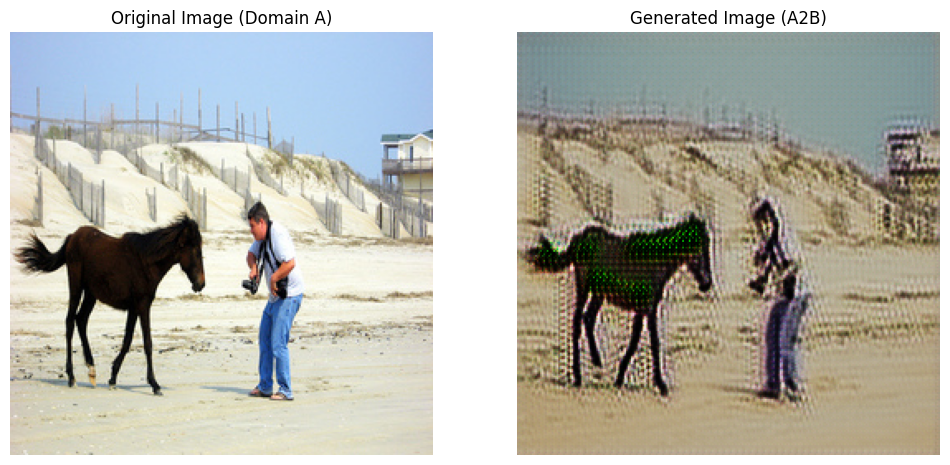

Epoch [2/50] Batch [0/1334] Loss_G: 7.4238 Loss_D_A: 0.2587 Loss_D_B: 0.2282
Epoch [2/50] Batch [100/1334] Loss_G: 8.4587 Loss_D_A: 0.1420 Loss_D_B: 0.0927
Epoch [2/50] Batch [200/1334] Loss_G: 6.2937 Loss_D_A: 0.2621 Loss_D_B: 0.4448
Epoch [2/50] Batch [300/1334] Loss_G: 6.1711 Loss_D_A: 0.1730 Loss_D_B: 0.0551
Epoch [2/50] Batch [400/1334] Loss_G: 8.3682 Loss_D_A: 0.6518 Loss_D_B: 0.1063
Epoch [2/50] Batch [500/1334] Loss_G: 6.7860 Loss_D_A: 0.2723 Loss_D_B: 0.1551
Epoch [2/50] Batch [600/1334] Loss_G: 6.4168 Loss_D_A: 0.2292 Loss_D_B: 0.3949
Epoch [2/50] Batch [700/1334] Loss_G: 9.0606 Loss_D_A: 0.2546 Loss_D_B: 0.0648
Epoch [2/50] Batch [800/1334] Loss_G: 6.8849 Loss_D_A: 0.3616 Loss_D_B: 0.3483
Epoch [2/50] Batch [900/1334] Loss_G: 9.0338 Loss_D_A: 0.1986 Loss_D_B: 0.2147
Epoch [2/50] Batch [1000/1334] Loss_G: 8.1275 Loss_D_A: 0.3672 Loss_D_B: 0.2121
Epoch [2/50] Batch [1100/1334] Loss_G: 6.7252 Loss_D_A: 0.0630 Loss_D_B: 0.1056
Epoch [2/50] Batch [1200/1334] Loss_G: 6.7215 Loss_D

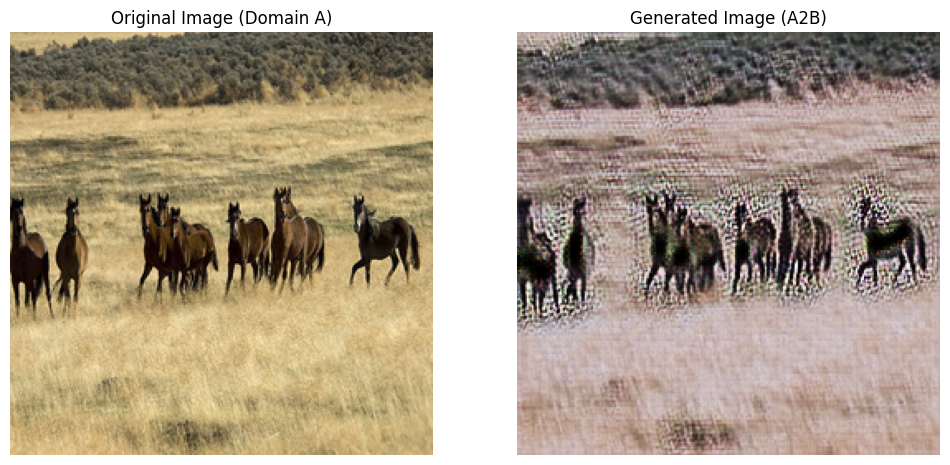

Epoch [3/50] Batch [0/1334] Loss_G: 7.4744 Loss_D_A: 0.1263 Loss_D_B: 0.2415
Epoch [3/50] Batch [100/1334] Loss_G: 9.0467 Loss_D_A: 0.1653 Loss_D_B: 0.1693
Epoch [3/50] Batch [200/1334] Loss_G: 6.8259 Loss_D_A: 0.2420 Loss_D_B: 0.4219
Epoch [3/50] Batch [300/1334] Loss_G: 5.4478 Loss_D_A: 0.3222 Loss_D_B: 0.1806
Epoch [3/50] Batch [400/1334] Loss_G: 6.2784 Loss_D_A: 0.1683 Loss_D_B: 0.1031
Epoch [3/50] Batch [500/1334] Loss_G: 6.5605 Loss_D_A: 0.2297 Loss_D_B: 0.1334
Epoch [3/50] Batch [600/1334] Loss_G: 6.8982 Loss_D_A: 0.2385 Loss_D_B: 0.1456
Epoch [3/50] Batch [700/1334] Loss_G: 9.5558 Loss_D_A: 0.1514 Loss_D_B: 0.1599
Epoch [3/50] Batch [800/1334] Loss_G: 7.4919 Loss_D_A: 0.1281 Loss_D_B: 0.2854
Epoch [3/50] Batch [900/1334] Loss_G: 9.8455 Loss_D_A: 0.2389 Loss_D_B: 0.2079
Epoch [3/50] Batch [1000/1334] Loss_G: 6.8699 Loss_D_A: 0.1076 Loss_D_B: 0.1798
Epoch [3/50] Batch [1100/1334] Loss_G: 5.9060 Loss_D_A: 0.1067 Loss_D_B: 0.0898
Epoch [3/50] Batch [1200/1334] Loss_G: 6.5576 Loss_D

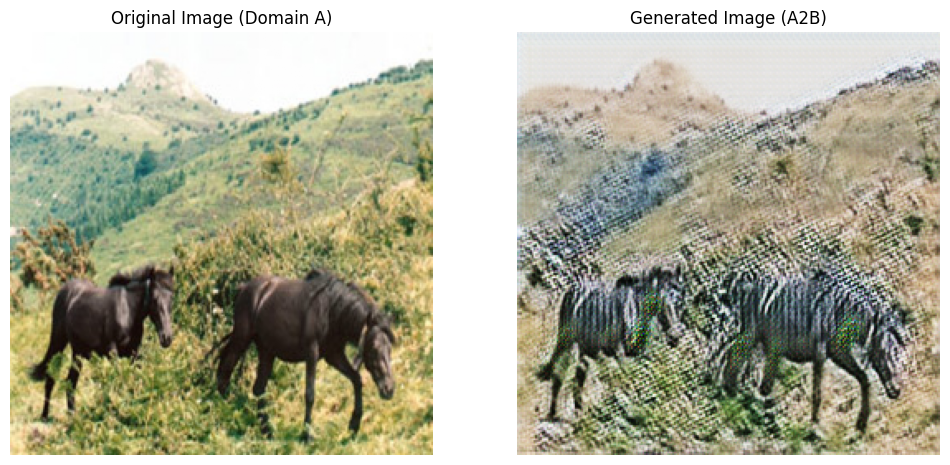

Epoch [4/50] Batch [0/1334] Loss_G: 9.8107 Loss_D_A: 0.2396 Loss_D_B: 0.1021
Epoch [4/50] Batch [100/1334] Loss_G: 5.2244 Loss_D_A: 0.1087 Loss_D_B: 0.2058
Epoch [4/50] Batch [200/1334] Loss_G: 4.9943 Loss_D_A: 0.2409 Loss_D_B: 0.1845
Epoch [4/50] Batch [300/1334] Loss_G: 5.0705 Loss_D_A: 0.1707 Loss_D_B: 0.0658
Epoch [4/50] Batch [400/1334] Loss_G: 8.1977 Loss_D_A: 0.3567 Loss_D_B: 0.2441
Epoch [4/50] Batch [500/1334] Loss_G: 7.5297 Loss_D_A: 0.3073 Loss_D_B: 0.1092
Epoch [4/50] Batch [600/1334] Loss_G: 6.0294 Loss_D_A: 0.2421 Loss_D_B: 0.1031
Epoch [4/50] Batch [700/1334] Loss_G: 5.5152 Loss_D_A: 0.2852 Loss_D_B: 0.1277
Epoch [4/50] Batch [800/1334] Loss_G: 5.7127 Loss_D_A: 0.2756 Loss_D_B: 0.1895
Epoch [4/50] Batch [900/1334] Loss_G: 9.5992 Loss_D_A: 0.3083 Loss_D_B: 0.4120
Epoch [4/50] Batch [1000/1334] Loss_G: 6.5195 Loss_D_A: 0.2046 Loss_D_B: 0.0694
Epoch [4/50] Batch [1100/1334] Loss_G: 5.3216 Loss_D_A: 0.3786 Loss_D_B: 0.2291
Epoch [4/50] Batch [1200/1334] Loss_G: 5.2573 Loss_D

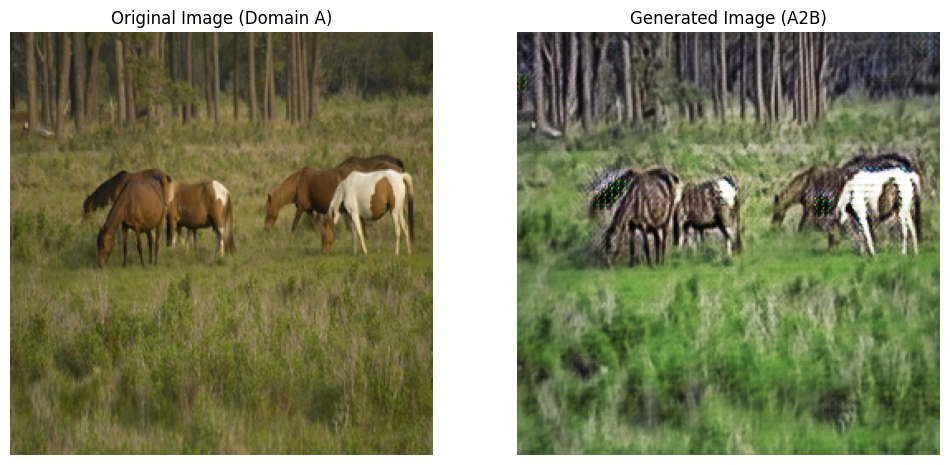

Epoch [5/50] Batch [0/1334] Loss_G: 6.4273 Loss_D_A: 0.2849 Loss_D_B: 0.0989
Epoch [5/50] Batch [100/1334] Loss_G: 9.3225 Loss_D_A: 0.1804 Loss_D_B: 0.1751
Epoch [5/50] Batch [200/1334] Loss_G: 5.6710 Loss_D_A: 0.2357 Loss_D_B: 0.1906
Epoch [5/50] Batch [300/1334] Loss_G: 7.7723 Loss_D_A: 0.3932 Loss_D_B: 0.0923
Epoch [5/50] Batch [400/1334] Loss_G: 7.9108 Loss_D_A: 0.3033 Loss_D_B: 0.3081
Epoch [5/50] Batch [500/1334] Loss_G: 7.5759 Loss_D_A: 0.3457 Loss_D_B: 0.2824
Epoch [5/50] Batch [600/1334] Loss_G: 5.2549 Loss_D_A: 0.1734 Loss_D_B: 0.0773
Epoch [5/50] Batch [700/1334] Loss_G: 4.9715 Loss_D_A: 0.4610 Loss_D_B: 0.3261
Epoch [5/50] Batch [800/1334] Loss_G: 7.1511 Loss_D_A: 0.3030 Loss_D_B: 0.3482
Epoch [5/50] Batch [900/1334] Loss_G: 5.7050 Loss_D_A: 0.1911 Loss_D_B: 0.3715
Epoch [5/50] Batch [1000/1334] Loss_G: 6.8286 Loss_D_A: 0.2740 Loss_D_B: 0.0721
Epoch [5/50] Batch [1100/1334] Loss_G: 6.6356 Loss_D_A: 0.2877 Loss_D_B: 0.1144
Epoch [5/50] Batch [1200/1334] Loss_G: 5.1385 Loss_D

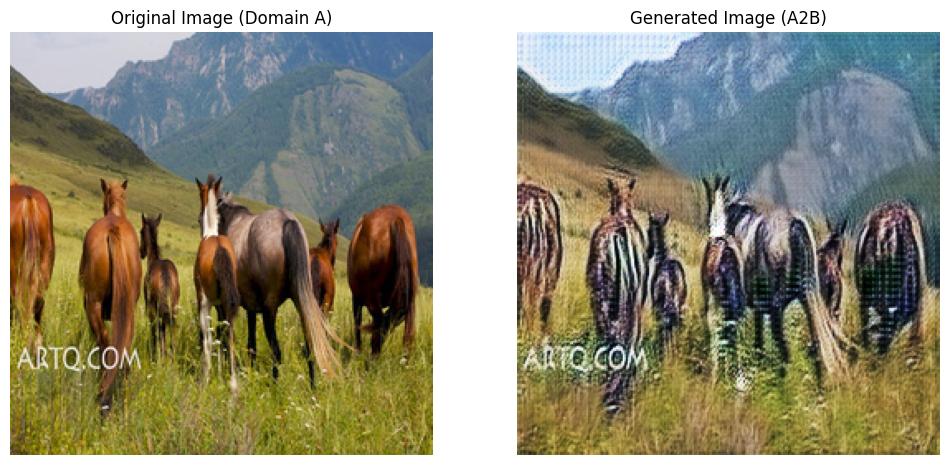

Epoch [6/50] Batch [0/1334] Loss_G: 7.7916 Loss_D_A: 0.1957 Loss_D_B: 0.3204
Epoch [6/50] Batch [100/1334] Loss_G: 5.6129 Loss_D_A: 0.1716 Loss_D_B: 0.1242
Epoch [6/50] Batch [200/1334] Loss_G: 5.9264 Loss_D_A: 0.2089 Loss_D_B: 0.1525
Epoch [6/50] Batch [300/1334] Loss_G: 6.7111 Loss_D_A: 0.0746 Loss_D_B: 0.2415
Epoch [6/50] Batch [400/1334] Loss_G: 4.8962 Loss_D_A: 0.2680 Loss_D_B: 0.3231
Epoch [6/50] Batch [500/1334] Loss_G: 4.0262 Loss_D_A: 0.3233 Loss_D_B: 0.1155
Epoch [6/50] Batch [600/1334] Loss_G: 4.7336 Loss_D_A: 0.2931 Loss_D_B: 0.1864
Epoch [6/50] Batch [700/1334] Loss_G: 4.8530 Loss_D_A: 0.2895 Loss_D_B: 0.1637
Epoch [6/50] Batch [800/1334] Loss_G: 6.4073 Loss_D_A: 0.2830 Loss_D_B: 0.3874
Epoch [6/50] Batch [900/1334] Loss_G: 5.6484 Loss_D_A: 0.3157 Loss_D_B: 0.1378
Epoch [6/50] Batch [1000/1334] Loss_G: 5.3632 Loss_D_A: 0.0984 Loss_D_B: 0.0774
Epoch [6/50] Batch [1100/1334] Loss_G: 5.9485 Loss_D_A: 0.5474 Loss_D_B: 0.1819
Epoch [6/50] Batch [1200/1334] Loss_G: 8.2033 Loss_D

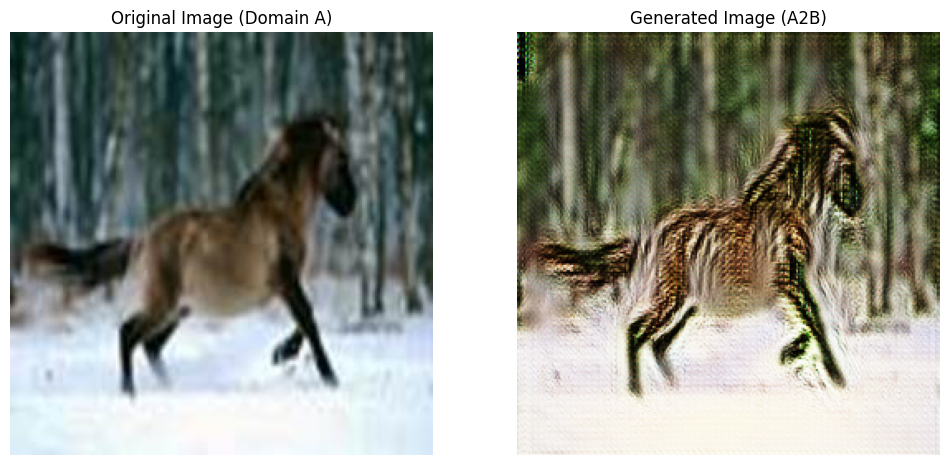

Epoch [7/50] Batch [0/1334] Loss_G: 5.3391 Loss_D_A: 0.2419 Loss_D_B: 0.3052
Epoch [7/50] Batch [100/1334] Loss_G: 6.4053 Loss_D_A: 0.3276 Loss_D_B: 0.1660
Epoch [7/50] Batch [200/1334] Loss_G: 5.5881 Loss_D_A: 0.0743 Loss_D_B: 0.0679
Epoch [7/50] Batch [300/1334] Loss_G: 5.5047 Loss_D_A: 0.0817 Loss_D_B: 0.0616
Epoch [7/50] Batch [400/1334] Loss_G: 5.4956 Loss_D_A: 0.3113 Loss_D_B: 0.2310
Epoch [7/50] Batch [500/1334] Loss_G: 6.1181 Loss_D_A: 0.1286 Loss_D_B: 0.2008
Epoch [7/50] Batch [600/1334] Loss_G: 6.3972 Loss_D_A: 0.1416 Loss_D_B: 0.0308
Epoch [7/50] Batch [700/1334] Loss_G: 5.7170 Loss_D_A: 0.2689 Loss_D_B: 0.2756
Epoch [7/50] Batch [800/1334] Loss_G: 5.4319 Loss_D_A: 0.4595 Loss_D_B: 0.3930
Epoch [7/50] Batch [900/1334] Loss_G: 4.7599 Loss_D_A: 0.2594 Loss_D_B: 0.1279
Epoch [7/50] Batch [1000/1334] Loss_G: 4.8481 Loss_D_A: 0.3469 Loss_D_B: 0.0755
Epoch [7/50] Batch [1100/1334] Loss_G: 5.0992 Loss_D_A: 0.2059 Loss_D_B: 0.2252
Epoch [7/50] Batch [1200/1334] Loss_G: 5.8426 Loss_D

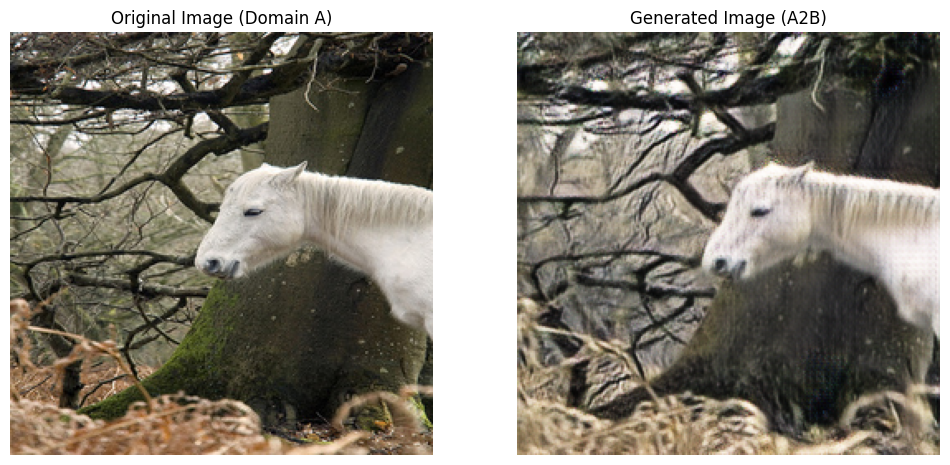

Epoch [8/50] Batch [0/1334] Loss_G: 5.0462 Loss_D_A: 0.1589 Loss_D_B: 0.0729
Epoch [8/50] Batch [100/1334] Loss_G: 4.4946 Loss_D_A: 0.2118 Loss_D_B: 0.1912
Epoch [8/50] Batch [200/1334] Loss_G: 5.7678 Loss_D_A: 0.0584 Loss_D_B: 0.0814
Epoch [8/50] Batch [300/1334] Loss_G: 5.6570 Loss_D_A: 0.1365 Loss_D_B: 0.2530
Epoch [8/50] Batch [400/1334] Loss_G: 6.5076 Loss_D_A: 0.2131 Loss_D_B: 0.4195
Epoch [8/50] Batch [500/1334] Loss_G: 8.6151 Loss_D_A: 0.5949 Loss_D_B: 0.6527
Epoch [8/50] Batch [600/1334] Loss_G: 8.8580 Loss_D_A: 0.2063 Loss_D_B: 0.0550
Epoch [8/50] Batch [700/1334] Loss_G: 5.3737 Loss_D_A: 0.4053 Loss_D_B: 0.1176
Epoch [8/50] Batch [800/1334] Loss_G: 4.4628 Loss_D_A: 0.2016 Loss_D_B: 0.1120
Epoch [8/50] Batch [900/1334] Loss_G: 6.3522 Loss_D_A: 0.0698 Loss_D_B: 0.0614
Epoch [8/50] Batch [1000/1334] Loss_G: 6.5959 Loss_D_A: 0.1982 Loss_D_B: 0.1718
Epoch [8/50] Batch [1100/1334] Loss_G: 5.6728 Loss_D_A: 0.1176 Loss_D_B: 0.0818
Epoch [8/50] Batch [1200/1334] Loss_G: 6.3065 Loss_D

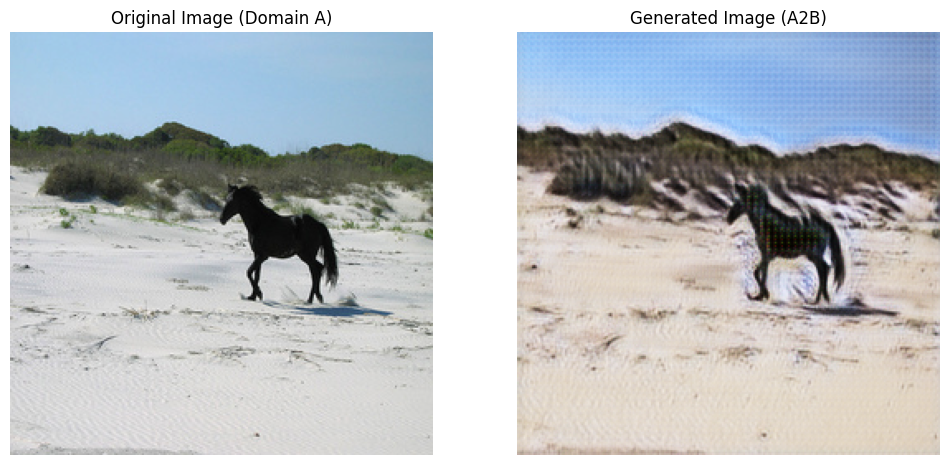

Epoch [9/50] Batch [0/1334] Loss_G: 5.2020 Loss_D_A: 0.1296 Loss_D_B: 0.1033
Epoch [9/50] Batch [100/1334] Loss_G: 4.1332 Loss_D_A: 0.1367 Loss_D_B: 0.2022
Epoch [9/50] Batch [200/1334] Loss_G: 4.6697 Loss_D_A: 0.1090 Loss_D_B: 0.1233
Epoch [9/50] Batch [300/1334] Loss_G: 5.9373 Loss_D_A: 0.2599 Loss_D_B: 0.1094
Epoch [9/50] Batch [400/1334] Loss_G: 6.7102 Loss_D_A: 0.1141 Loss_D_B: 0.1856
Epoch [9/50] Batch [500/1334] Loss_G: 4.1552 Loss_D_A: 0.2899 Loss_D_B: 0.2451
Epoch [9/50] Batch [600/1334] Loss_G: 5.2489 Loss_D_A: 0.2711 Loss_D_B: 0.1241
Epoch [9/50] Batch [700/1334] Loss_G: 5.8780 Loss_D_A: 0.3596 Loss_D_B: 0.1095
Epoch [9/50] Batch [800/1334] Loss_G: 5.6881 Loss_D_A: 0.1848 Loss_D_B: 0.2805
Epoch [9/50] Batch [900/1334] Loss_G: 4.5094 Loss_D_A: 0.2488 Loss_D_B: 0.1886
Epoch [9/50] Batch [1000/1334] Loss_G: 6.8079 Loss_D_A: 0.1131 Loss_D_B: 0.0353
Epoch [9/50] Batch [1100/1334] Loss_G: 4.4941 Loss_D_A: 0.1062 Loss_D_B: 0.0827
Epoch [9/50] Batch [1200/1334] Loss_G: 6.4213 Loss_D

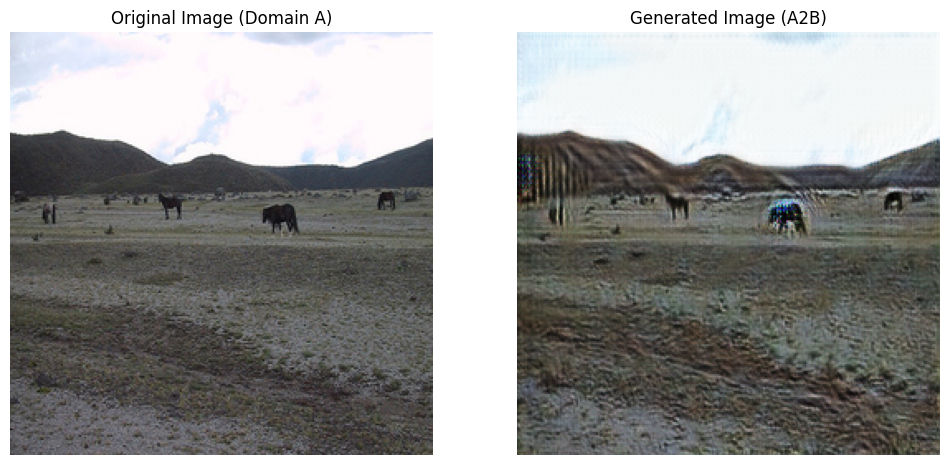

Epoch [10/50] Batch [0/1334] Loss_G: 5.8208 Loss_D_A: 0.4671 Loss_D_B: 0.4937
Epoch [10/50] Batch [100/1334] Loss_G: 5.6213 Loss_D_A: 0.1460 Loss_D_B: 0.1057
Epoch [10/50] Batch [200/1334] Loss_G: 5.0346 Loss_D_A: 0.2694 Loss_D_B: 0.3021
Epoch [10/50] Batch [300/1334] Loss_G: 6.7879 Loss_D_A: 0.1620 Loss_D_B: 0.1864
Epoch [10/50] Batch [400/1334] Loss_G: 5.6480 Loss_D_A: 0.2508 Loss_D_B: 0.3639
Epoch [10/50] Batch [500/1334] Loss_G: 6.0481 Loss_D_A: 0.1862 Loss_D_B: 0.0526
Epoch [10/50] Batch [600/1334] Loss_G: 3.9605 Loss_D_A: 0.1604 Loss_D_B: 0.0830
Epoch [10/50] Batch [700/1334] Loss_G: 5.3025 Loss_D_A: 0.2035 Loss_D_B: 0.1260
Epoch [10/50] Batch [800/1334] Loss_G: 5.6959 Loss_D_A: 0.2310 Loss_D_B: 0.1777
Epoch [10/50] Batch [900/1334] Loss_G: 9.0632 Loss_D_A: 0.0957 Loss_D_B: 0.0970
Epoch [10/50] Batch [1000/1334] Loss_G: 5.2068 Loss_D_A: 0.2187 Loss_D_B: 0.1201
Epoch [10/50] Batch [1100/1334] Loss_G: 7.3715 Loss_D_A: 0.1616 Loss_D_B: 0.2294
Epoch [10/50] Batch [1200/1334] Loss_G: 

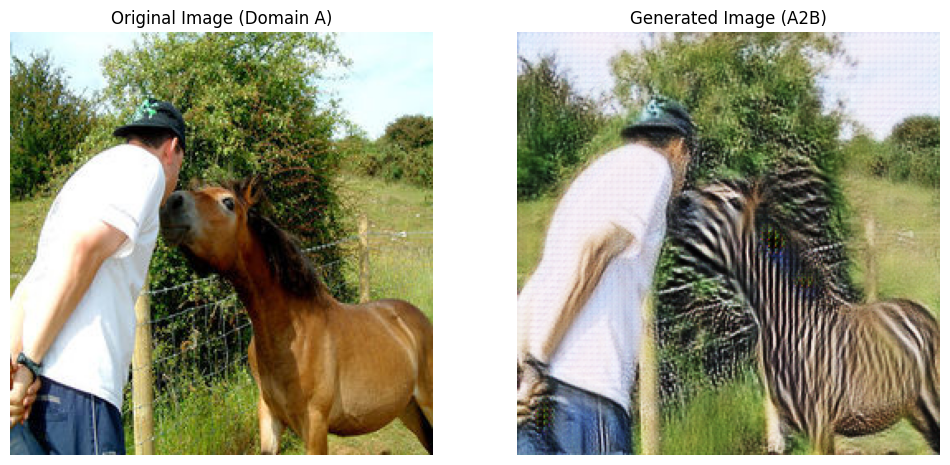

Epoch [11/50] Batch [0/1334] Loss_G: 5.2393 Loss_D_A: 0.1102 Loss_D_B: 0.1161
Epoch [11/50] Batch [100/1334] Loss_G: 4.5069 Loss_D_A: 0.1367 Loss_D_B: 0.0439
Epoch [11/50] Batch [200/1334] Loss_G: 4.2949 Loss_D_A: 0.1805 Loss_D_B: 0.3638
Epoch [11/50] Batch [300/1334] Loss_G: 5.2740 Loss_D_A: 0.1724 Loss_D_B: 0.1710
Epoch [11/50] Batch [400/1334] Loss_G: 4.0047 Loss_D_A: 0.0752 Loss_D_B: 0.0478
Epoch [11/50] Batch [500/1334] Loss_G: 9.4859 Loss_D_A: 0.1781 Loss_D_B: 0.0839
Epoch [11/50] Batch [600/1334] Loss_G: 4.4757 Loss_D_A: 0.1670 Loss_D_B: 0.2373
Epoch [11/50] Batch [700/1334] Loss_G: 6.8580 Loss_D_A: 0.1404 Loss_D_B: 0.0945
Epoch [11/50] Batch [800/1334] Loss_G: 6.5433 Loss_D_A: 0.2360 Loss_D_B: 0.0551
Epoch [11/50] Batch [900/1334] Loss_G: 6.7596 Loss_D_A: 0.1210 Loss_D_B: 0.2882
Epoch [11/50] Batch [1000/1334] Loss_G: 6.2061 Loss_D_A: 0.1947 Loss_D_B: 0.1600
Epoch [11/50] Batch [1100/1334] Loss_G: 3.9829 Loss_D_A: 0.2820 Loss_D_B: 0.4214
Epoch [11/50] Batch [1200/1334] Loss_G: 

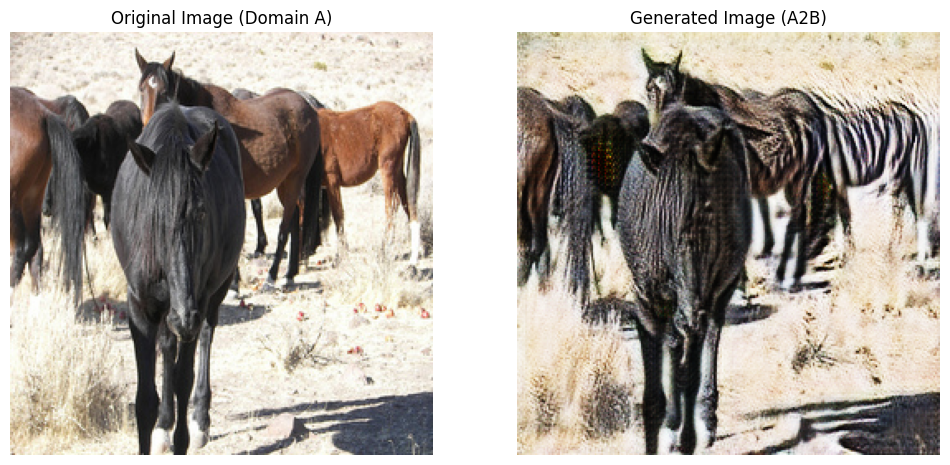

Epoch [12/50] Batch [0/1334] Loss_G: 4.3753 Loss_D_A: 0.1194 Loss_D_B: 0.1116
Epoch [12/50] Batch [100/1334] Loss_G: 5.2770 Loss_D_A: 0.1728 Loss_D_B: 0.1402
Epoch [12/50] Batch [200/1334] Loss_G: 4.1160 Loss_D_A: 0.2328 Loss_D_B: 0.1047
Epoch [12/50] Batch [300/1334] Loss_G: 5.4277 Loss_D_A: 0.1636 Loss_D_B: 0.3054
Epoch [12/50] Batch [400/1334] Loss_G: 8.5725 Loss_D_A: 0.2326 Loss_D_B: 0.1059
Epoch [12/50] Batch [500/1334] Loss_G: 6.8861 Loss_D_A: 0.0873 Loss_D_B: 0.1892
Epoch [12/50] Batch [600/1334] Loss_G: 6.9073 Loss_D_A: 0.2740 Loss_D_B: 0.3274
Epoch [12/50] Batch [700/1334] Loss_G: 4.5480 Loss_D_A: 0.1336 Loss_D_B: 0.1395
Epoch [12/50] Batch [800/1334] Loss_G: 7.0415 Loss_D_A: 0.1716 Loss_D_B: 0.2222
Epoch [12/50] Batch [900/1334] Loss_G: 5.0272 Loss_D_A: 0.1851 Loss_D_B: 0.1164
Epoch [12/50] Batch [1000/1334] Loss_G: 5.4958 Loss_D_A: 0.8039 Loss_D_B: 0.3518
Epoch [12/50] Batch [1100/1334] Loss_G: 4.9651 Loss_D_A: 0.0755 Loss_D_B: 0.2017
Epoch [12/50] Batch [1200/1334] Loss_G: 

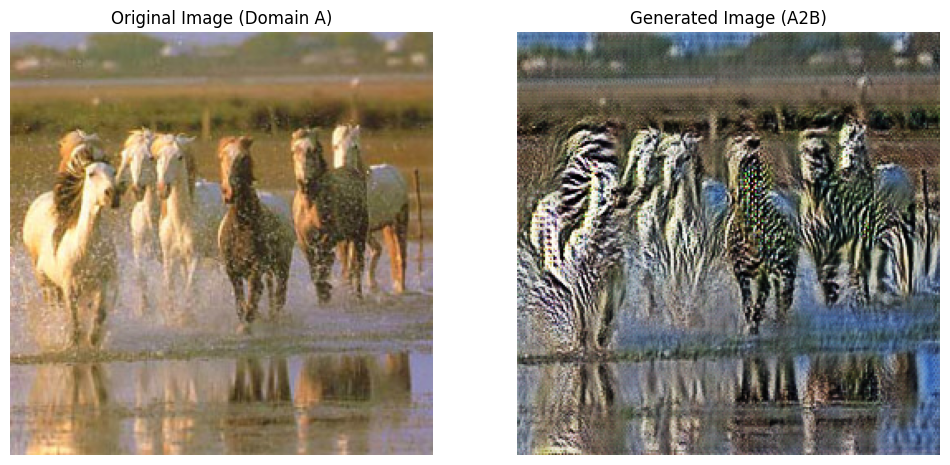

Epoch [13/50] Batch [0/1334] Loss_G: 4.9493 Loss_D_A: 0.1761 Loss_D_B: 0.1906
Epoch [13/50] Batch [100/1334] Loss_G: 4.5022 Loss_D_A: 0.1415 Loss_D_B: 0.3256
Epoch [13/50] Batch [200/1334] Loss_G: 5.4221 Loss_D_A: 0.1209 Loss_D_B: 0.0707
Epoch [13/50] Batch [300/1334] Loss_G: 7.5729 Loss_D_A: 0.2261 Loss_D_B: 0.0599
Epoch [13/50] Batch [400/1334] Loss_G: 4.8054 Loss_D_A: 0.1956 Loss_D_B: 0.1147
Epoch [13/50] Batch [500/1334] Loss_G: 4.5906 Loss_D_A: 0.2252 Loss_D_B: 0.0349
Epoch [13/50] Batch [600/1334] Loss_G: 5.1212 Loss_D_A: 0.2518 Loss_D_B: 0.1457
Epoch [13/50] Batch [700/1334] Loss_G: 6.7456 Loss_D_A: 0.0941 Loss_D_B: 0.1537
Epoch [13/50] Batch [800/1334] Loss_G: 3.9014 Loss_D_A: 0.1206 Loss_D_B: 0.0822
Epoch [13/50] Batch [900/1334] Loss_G: 5.8096 Loss_D_A: 0.2657 Loss_D_B: 0.3885
Epoch [13/50] Batch [1000/1334] Loss_G: 4.7306 Loss_D_A: 0.2709 Loss_D_B: 0.2692
Epoch [13/50] Batch [1100/1334] Loss_G: 4.4544 Loss_D_A: 0.3035 Loss_D_B: 0.1360
Epoch [13/50] Batch [1200/1334] Loss_G: 

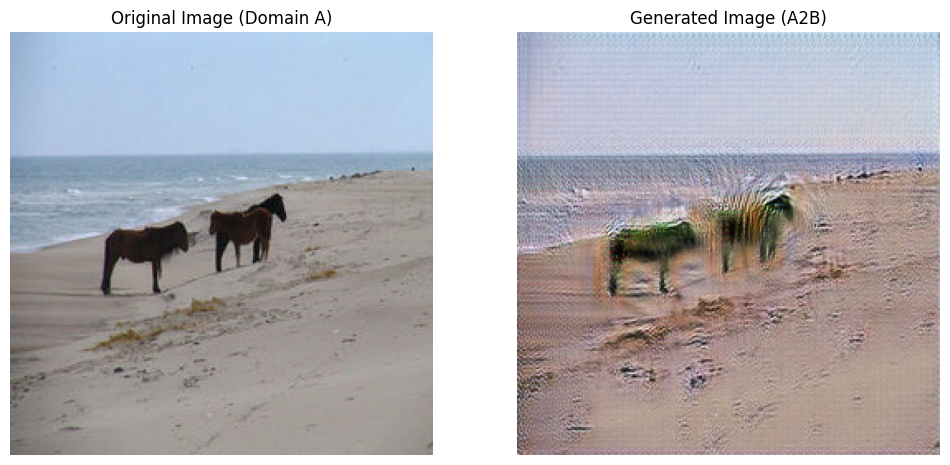

Epoch [14/50] Batch [0/1334] Loss_G: 4.5310 Loss_D_A: 0.0965 Loss_D_B: 0.1718
Epoch [14/50] Batch [100/1334] Loss_G: 5.2252 Loss_D_A: 0.1545 Loss_D_B: 0.0939
Epoch [14/50] Batch [200/1334] Loss_G: 4.7612 Loss_D_A: 0.1774 Loss_D_B: 0.0591
Epoch [14/50] Batch [300/1334] Loss_G: 4.7867 Loss_D_A: 0.1521 Loss_D_B: 0.0376
Epoch [14/50] Batch [400/1334] Loss_G: 5.8165 Loss_D_A: 0.2907 Loss_D_B: 0.1325
Epoch [14/50] Batch [500/1334] Loss_G: 4.0742 Loss_D_A: 0.1793 Loss_D_B: 0.2816
Epoch [14/50] Batch [600/1334] Loss_G: 5.2080 Loss_D_A: 0.0324 Loss_D_B: 0.0756
Epoch [14/50] Batch [700/1334] Loss_G: 5.5295 Loss_D_A: 0.2757 Loss_D_B: 0.3566
Epoch [14/50] Batch [800/1334] Loss_G: 6.3664 Loss_D_A: 0.2562 Loss_D_B: 0.1316
Epoch [14/50] Batch [900/1334] Loss_G: 7.0093 Loss_D_A: 0.1224 Loss_D_B: 0.3033
Epoch [14/50] Batch [1000/1334] Loss_G: 4.3265 Loss_D_A: 0.2844 Loss_D_B: 0.0856
Epoch [14/50] Batch [1100/1334] Loss_G: 7.5656 Loss_D_A: 0.2091 Loss_D_B: 0.1658
Epoch [14/50] Batch [1200/1334] Loss_G: 

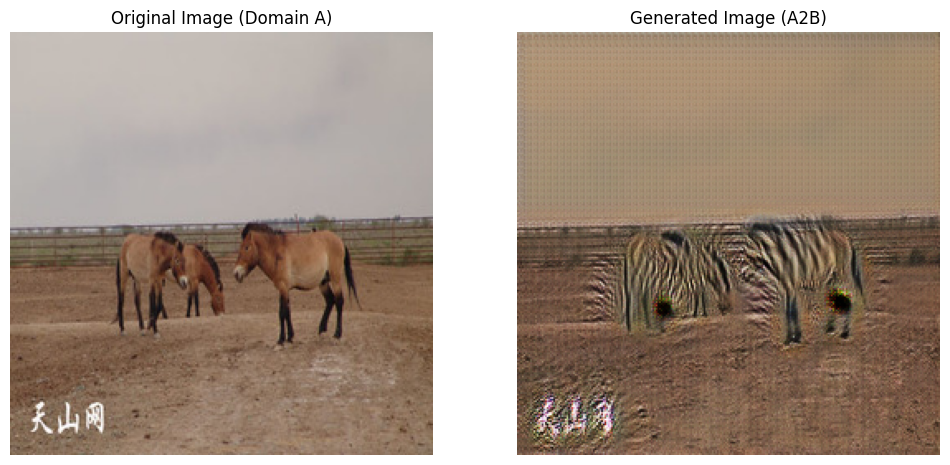

Epoch [15/50] Batch [0/1334] Loss_G: 5.7150 Loss_D_A: 0.0574 Loss_D_B: 0.0343
Epoch [15/50] Batch [100/1334] Loss_G: 3.6458 Loss_D_A: 0.1807 Loss_D_B: 0.2462
Epoch [15/50] Batch [200/1334] Loss_G: 4.2880 Loss_D_A: 0.2873 Loss_D_B: 0.1198
Epoch [15/50] Batch [300/1334] Loss_G: 5.7934 Loss_D_A: 0.1786 Loss_D_B: 0.0908
Epoch [15/50] Batch [400/1334] Loss_G: 4.7273 Loss_D_A: 0.1577 Loss_D_B: 0.1074
Epoch [15/50] Batch [500/1334] Loss_G: 6.1153 Loss_D_A: 0.1818 Loss_D_B: 0.3119
Epoch [15/50] Batch [600/1334] Loss_G: 6.2228 Loss_D_A: 0.0647 Loss_D_B: 0.0665
Epoch [15/50] Batch [700/1334] Loss_G: 4.5659 Loss_D_A: 0.3759 Loss_D_B: 0.1996
Epoch [15/50] Batch [800/1334] Loss_G: 4.2720 Loss_D_A: 0.3086 Loss_D_B: 0.1881
Epoch [15/50] Batch [900/1334] Loss_G: 5.6268 Loss_D_A: 0.0656 Loss_D_B: 0.4882
Epoch [15/50] Batch [1000/1334] Loss_G: 5.1781 Loss_D_A: 0.2145 Loss_D_B: 0.1729
Epoch [15/50] Batch [1100/1334] Loss_G: 5.6275 Loss_D_A: 0.0850 Loss_D_B: 0.0280
Epoch [15/50] Batch [1200/1334] Loss_G: 

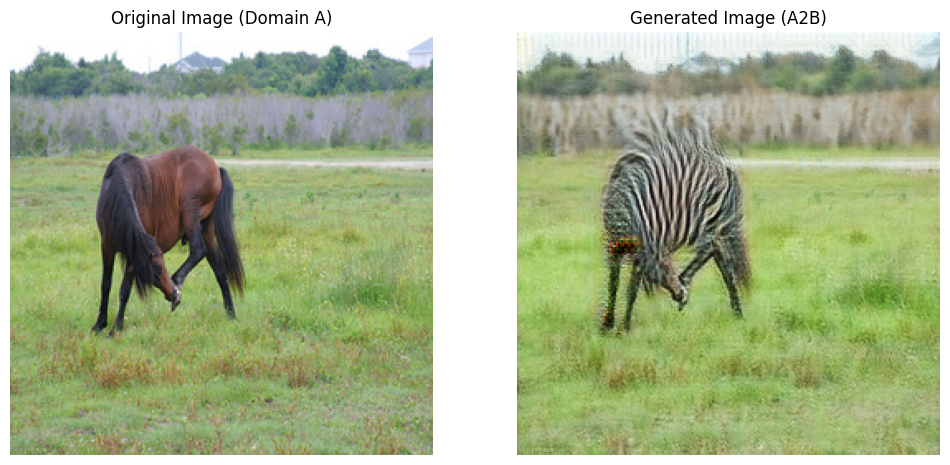

Epoch [16/50] Batch [0/1334] Loss_G: 5.7071 Loss_D_A: 0.0768 Loss_D_B: 0.1163
Epoch [16/50] Batch [100/1334] Loss_G: 4.9541 Loss_D_A: 0.2021 Loss_D_B: 0.2976
Epoch [16/50] Batch [200/1334] Loss_G: 9.4105 Loss_D_A: 0.1190 Loss_D_B: 0.3858
Epoch [16/50] Batch [300/1334] Loss_G: 4.1679 Loss_D_A: 0.2145 Loss_D_B: 0.2561
Epoch [16/50] Batch [400/1334] Loss_G: 4.4242 Loss_D_A: 0.1342 Loss_D_B: 0.1004
Epoch [16/50] Batch [500/1334] Loss_G: 4.0317 Loss_D_A: 0.5112 Loss_D_B: 0.6740
Epoch [16/50] Batch [600/1334] Loss_G: 3.9355 Loss_D_A: 0.1992 Loss_D_B: 0.3611
Epoch [16/50] Batch [700/1334] Loss_G: 5.3791 Loss_D_A: 0.1265 Loss_D_B: 0.2279
Epoch [16/50] Batch [800/1334] Loss_G: 5.3400 Loss_D_A: 0.2811 Loss_D_B: 0.1255
Epoch [16/50] Batch [900/1334] Loss_G: 4.5581 Loss_D_A: 0.1529 Loss_D_B: 0.1058
Epoch [16/50] Batch [1000/1334] Loss_G: 5.0887 Loss_D_A: 0.0865 Loss_D_B: 0.0180
Epoch [16/50] Batch [1100/1334] Loss_G: 5.0883 Loss_D_A: 0.3015 Loss_D_B: 0.1733
Epoch [16/50] Batch [1200/1334] Loss_G: 

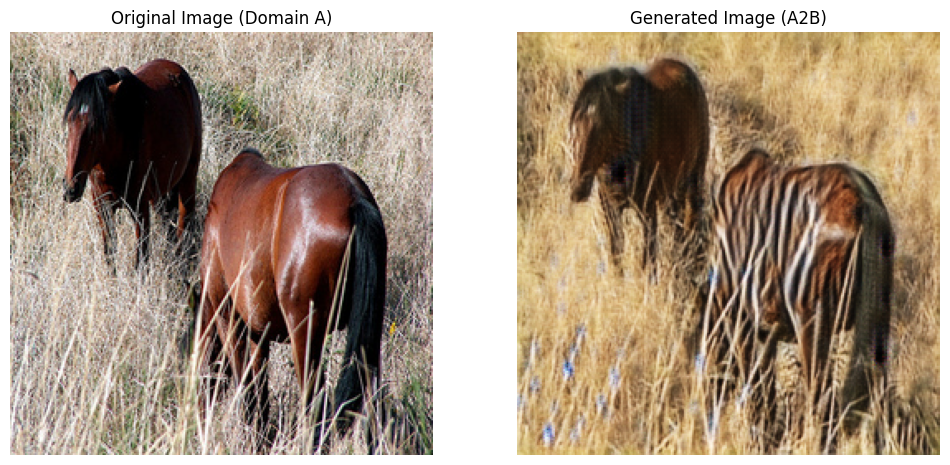

Epoch [17/50] Batch [0/1334] Loss_G: 9.3870 Loss_D_A: 0.3898 Loss_D_B: 0.1711
Epoch [17/50] Batch [100/1334] Loss_G: 5.2737 Loss_D_A: 0.2187 Loss_D_B: 0.0416
Epoch [17/50] Batch [200/1334] Loss_G: 4.5241 Loss_D_A: 0.0240 Loss_D_B: 0.0643
Epoch [17/50] Batch [300/1334] Loss_G: 3.9777 Loss_D_A: 0.2861 Loss_D_B: 0.1125
Epoch [17/50] Batch [400/1334] Loss_G: 5.2261 Loss_D_A: 0.1943 Loss_D_B: 0.0603
Epoch [17/50] Batch [500/1334] Loss_G: 4.2634 Loss_D_A: 0.1966 Loss_D_B: 0.1076
Epoch [17/50] Batch [600/1334] Loss_G: 5.3199 Loss_D_A: 0.0730 Loss_D_B: 0.0996
Epoch [17/50] Batch [700/1334] Loss_G: 5.8364 Loss_D_A: 0.1358 Loss_D_B: 0.0524
Epoch [17/50] Batch [800/1334] Loss_G: 5.1194 Loss_D_A: 0.1883 Loss_D_B: 0.1333
Epoch [17/50] Batch [900/1334] Loss_G: 5.3667 Loss_D_A: 0.2057 Loss_D_B: 0.1507
Epoch [17/50] Batch [1000/1334] Loss_G: 5.9088 Loss_D_A: 0.2287 Loss_D_B: 0.4439
Epoch [17/50] Batch [1100/1334] Loss_G: 6.3234 Loss_D_A: 0.1540 Loss_D_B: 0.1566
Epoch [17/50] Batch [1200/1334] Loss_G: 

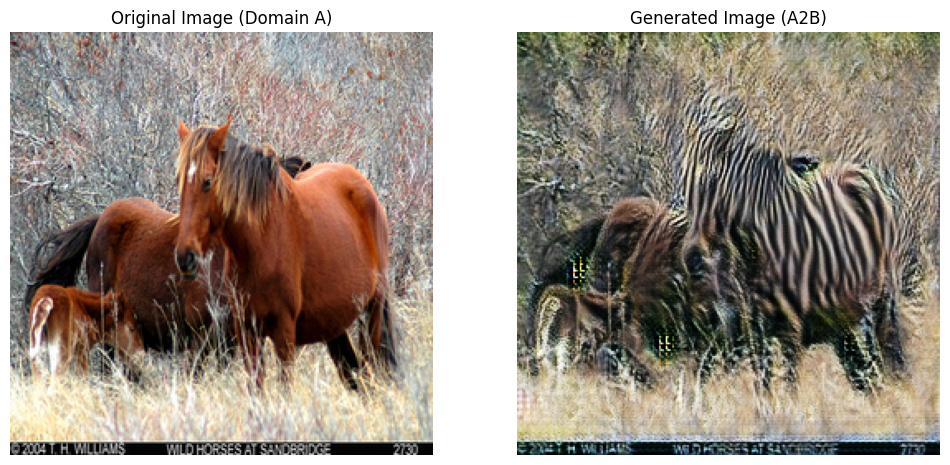

Epoch [18/50] Batch [0/1334] Loss_G: 5.4513 Loss_D_A: 0.2954 Loss_D_B: 0.1170
Epoch [18/50] Batch [100/1334] Loss_G: 5.2779 Loss_D_A: 0.2093 Loss_D_B: 0.0779
Epoch [18/50] Batch [200/1334] Loss_G: 4.1066 Loss_D_A: 0.1432 Loss_D_B: 0.0417
Epoch [18/50] Batch [300/1334] Loss_G: 6.2199 Loss_D_A: 0.4763 Loss_D_B: 0.1462
Epoch [18/50] Batch [400/1334] Loss_G: 8.0843 Loss_D_A: 0.1561 Loss_D_B: 0.5639
Epoch [18/50] Batch [500/1334] Loss_G: 5.6977 Loss_D_A: 0.2653 Loss_D_B: 0.0837
Epoch [18/50] Batch [600/1334] Loss_G: 5.9004 Loss_D_A: 0.0937 Loss_D_B: 0.0273
Epoch [18/50] Batch [700/1334] Loss_G: 4.9096 Loss_D_A: 0.1790 Loss_D_B: 0.1476
Epoch [18/50] Batch [800/1334] Loss_G: 5.1272 Loss_D_A: 0.1142 Loss_D_B: 0.2034
Epoch [18/50] Batch [900/1334] Loss_G: 7.0337 Loss_D_A: 0.2267 Loss_D_B: 0.3703
Epoch [18/50] Batch [1000/1334] Loss_G: 4.5405 Loss_D_A: 0.1573 Loss_D_B: 0.2985
Epoch [18/50] Batch [1100/1334] Loss_G: 7.4647 Loss_D_A: 0.0757 Loss_D_B: 0.0435
Epoch [18/50] Batch [1200/1334] Loss_G: 

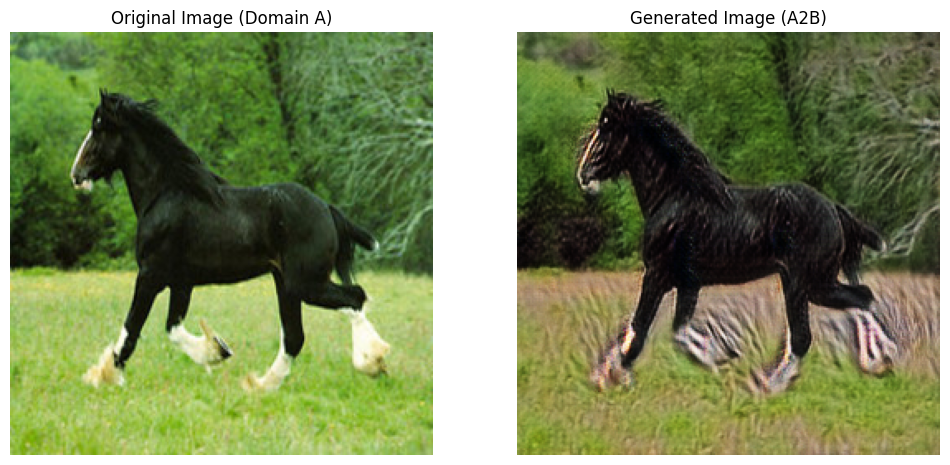

Epoch [19/50] Batch [0/1334] Loss_G: 6.1165 Loss_D_A: 0.0687 Loss_D_B: 0.0603
Epoch [19/50] Batch [100/1334] Loss_G: 4.2927 Loss_D_A: 0.3066 Loss_D_B: 0.2459
Epoch [19/50] Batch [200/1334] Loss_G: 6.2031 Loss_D_A: 0.2349 Loss_D_B: 0.1587
Epoch [19/50] Batch [300/1334] Loss_G: 3.2641 Loss_D_A: 0.2301 Loss_D_B: 0.2741
Epoch [19/50] Batch [400/1334] Loss_G: 4.9976 Loss_D_A: 0.1496 Loss_D_B: 0.1798
Epoch [19/50] Batch [500/1334] Loss_G: 6.3831 Loss_D_A: 0.1557 Loss_D_B: 0.1323
Epoch [19/50] Batch [600/1334] Loss_G: 5.1722 Loss_D_A: 0.3382 Loss_D_B: 0.0592
Epoch [19/50] Batch [700/1334] Loss_G: 4.8486 Loss_D_A: 0.2732 Loss_D_B: 0.1181
Epoch [19/50] Batch [800/1334] Loss_G: 5.0558 Loss_D_A: 0.3849 Loss_D_B: 0.1502
Epoch [19/50] Batch [900/1334] Loss_G: 5.3243 Loss_D_A: 0.1655 Loss_D_B: 0.0941
Epoch [19/50] Batch [1000/1334] Loss_G: 3.7036 Loss_D_A: 0.2607 Loss_D_B: 0.3781
Epoch [19/50] Batch [1100/1334] Loss_G: 4.2732 Loss_D_A: 0.0965 Loss_D_B: 0.1958
Epoch [19/50] Batch [1200/1334] Loss_G: 

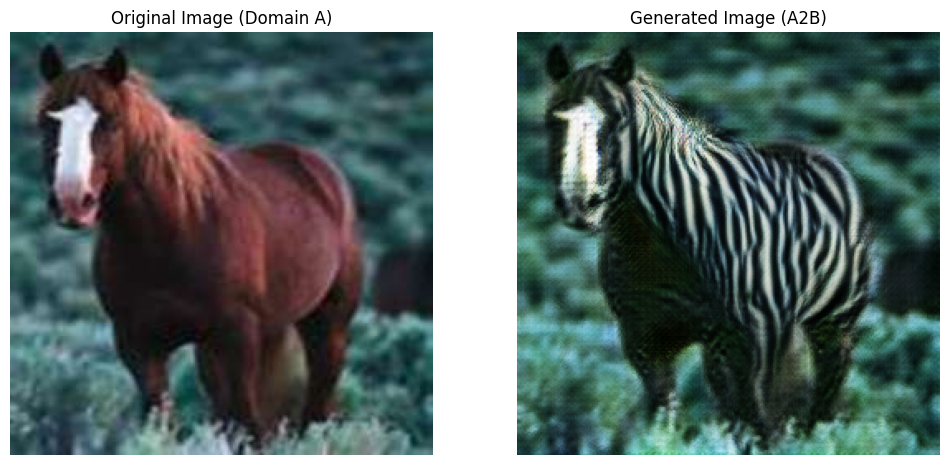

Epoch [20/50] Batch [0/1334] Loss_G: 4.3511 Loss_D_A: 0.3860 Loss_D_B: 0.2591
Epoch [20/50] Batch [100/1334] Loss_G: 6.5231 Loss_D_A: 0.1865 Loss_D_B: 0.0713
Epoch [20/50] Batch [200/1334] Loss_G: 3.8462 Loss_D_A: 0.1709 Loss_D_B: 0.1502
Epoch [20/50] Batch [300/1334] Loss_G: 5.0662 Loss_D_A: 0.1047 Loss_D_B: 0.0793
Epoch [20/50] Batch [400/1334] Loss_G: 6.8491 Loss_D_A: 0.2209 Loss_D_B: 0.0814
Epoch [20/50] Batch [500/1334] Loss_G: 6.6621 Loss_D_A: 0.0976 Loss_D_B: 0.0494
Epoch [20/50] Batch [600/1334] Loss_G: 5.7700 Loss_D_A: 0.2898 Loss_D_B: 0.1028
Epoch [20/50] Batch [700/1334] Loss_G: 5.7069 Loss_D_A: 0.1716 Loss_D_B: 0.3489
Epoch [20/50] Batch [800/1334] Loss_G: 5.4293 Loss_D_A: 0.2464 Loss_D_B: 0.1590
Epoch [20/50] Batch [900/1334] Loss_G: 4.7036 Loss_D_A: 0.2360 Loss_D_B: 0.2048
Epoch [20/50] Batch [1000/1334] Loss_G: 4.4373 Loss_D_A: 0.1050 Loss_D_B: 0.0589
Epoch [20/50] Batch [1100/1334] Loss_G: 4.5229 Loss_D_A: 0.1347 Loss_D_B: 0.0999
Epoch [20/50] Batch [1200/1334] Loss_G: 

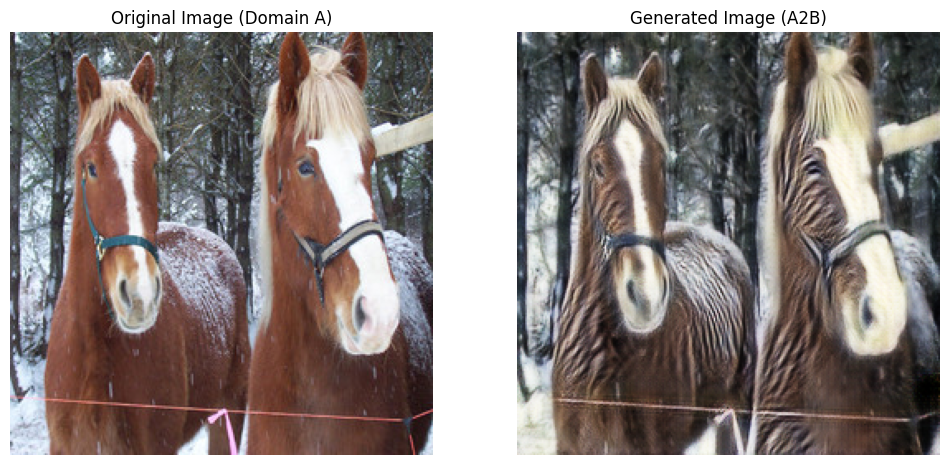

Epoch [21/50] Batch [0/1334] Loss_G: 5.0405 Loss_D_A: 0.2522 Loss_D_B: 0.2647
Epoch [21/50] Batch [100/1334] Loss_G: 3.7994 Loss_D_A: 0.4893 Loss_D_B: 0.1888
Epoch [21/50] Batch [200/1334] Loss_G: 6.7068 Loss_D_A: 0.1032 Loss_D_B: 0.0345
Epoch [21/50] Batch [300/1334] Loss_G: 4.6919 Loss_D_A: 0.1779 Loss_D_B: 0.1589
Epoch [21/50] Batch [400/1334] Loss_G: 4.4253 Loss_D_A: 0.2217 Loss_D_B: 0.2524
Epoch [21/50] Batch [500/1334] Loss_G: 5.5294 Loss_D_A: 0.0844 Loss_D_B: 0.0482
Epoch [21/50] Batch [600/1334] Loss_G: 4.3968 Loss_D_A: 0.3883 Loss_D_B: 0.4314
Epoch [21/50] Batch [700/1334] Loss_G: 6.3030 Loss_D_A: 0.0474 Loss_D_B: 0.0431
Epoch [21/50] Batch [800/1334] Loss_G: 3.3684 Loss_D_A: 0.2441 Loss_D_B: 0.1290
Epoch [21/50] Batch [900/1334] Loss_G: 4.8166 Loss_D_A: 0.1134 Loss_D_B: 0.1306
Epoch [21/50] Batch [1000/1334] Loss_G: 4.2600 Loss_D_A: 0.1584 Loss_D_B: 0.1611
Epoch [21/50] Batch [1100/1334] Loss_G: 4.6972 Loss_D_A: 0.0830 Loss_D_B: 0.0750
Epoch [21/50] Batch [1200/1334] Loss_G: 

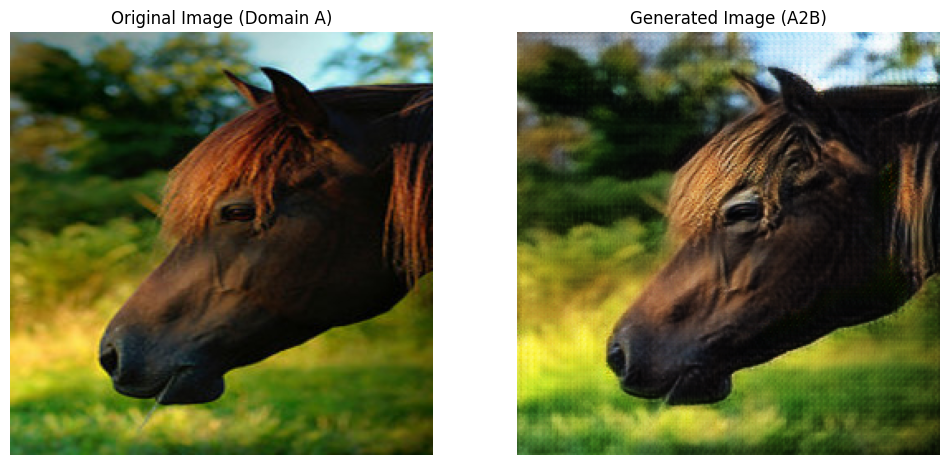

Epoch [22/50] Batch [0/1334] Loss_G: 4.3188 Loss_D_A: 0.2448 Loss_D_B: 0.1654
Epoch [22/50] Batch [100/1334] Loss_G: 4.8199 Loss_D_A: 0.2323 Loss_D_B: 0.2256
Epoch [22/50] Batch [200/1334] Loss_G: 5.9378 Loss_D_A: 0.1134 Loss_D_B: 0.0867
Epoch [22/50] Batch [300/1334] Loss_G: 5.0137 Loss_D_A: 0.1778 Loss_D_B: 0.0814
Epoch [22/50] Batch [400/1334] Loss_G: 4.2690 Loss_D_A: 0.0792 Loss_D_B: 0.0407
Epoch [22/50] Batch [500/1334] Loss_G: 3.6536 Loss_D_A: 0.4354 Loss_D_B: 0.4105
Epoch [22/50] Batch [600/1334] Loss_G: 4.6243 Loss_D_A: 0.1784 Loss_D_B: 0.0916
Epoch [22/50] Batch [700/1334] Loss_G: 3.8708 Loss_D_A: 0.2850 Loss_D_B: 0.3016
Epoch [22/50] Batch [800/1334] Loss_G: 4.1285 Loss_D_A: 0.1222 Loss_D_B: 0.4080
Epoch [22/50] Batch [900/1334] Loss_G: 5.0193 Loss_D_A: 0.1125 Loss_D_B: 0.2298
Epoch [22/50] Batch [1000/1334] Loss_G: 4.8188 Loss_D_A: 0.1871 Loss_D_B: 0.2494
Epoch [22/50] Batch [1100/1334] Loss_G: 4.3576 Loss_D_A: 0.1456 Loss_D_B: 0.2166
Epoch [22/50] Batch [1200/1334] Loss_G: 

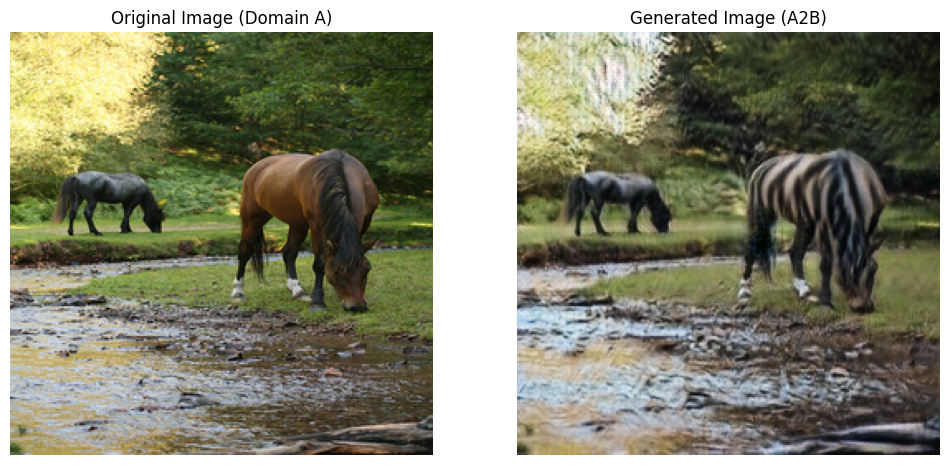

Epoch [23/50] Batch [0/1334] Loss_G: 4.9990 Loss_D_A: 0.1622 Loss_D_B: 0.0942
Epoch [23/50] Batch [100/1334] Loss_G: 2.6754 Loss_D_A: 0.3595 Loss_D_B: 0.1995
Epoch [23/50] Batch [200/1334] Loss_G: 3.7888 Loss_D_A: 0.2136 Loss_D_B: 0.0904
Epoch [23/50] Batch [300/1334] Loss_G: 5.4649 Loss_D_A: 0.1499 Loss_D_B: 0.2714
Epoch [23/50] Batch [400/1334] Loss_G: 4.0817 Loss_D_A: 0.2887 Loss_D_B: 0.1748
Epoch [23/50] Batch [500/1334] Loss_G: 4.8283 Loss_D_A: 0.1954 Loss_D_B: 0.0969
Epoch [23/50] Batch [600/1334] Loss_G: 5.8889 Loss_D_A: 0.2474 Loss_D_B: 0.1215
Epoch [23/50] Batch [700/1334] Loss_G: 4.3581 Loss_D_A: 0.0703 Loss_D_B: 0.1435
Epoch [23/50] Batch [800/1334] Loss_G: 6.1130 Loss_D_A: 0.0988 Loss_D_B: 0.0770
Epoch [23/50] Batch [900/1334] Loss_G: 5.7931 Loss_D_A: 0.0555 Loss_D_B: 0.0467
Epoch [23/50] Batch [1000/1334] Loss_G: 4.6637 Loss_D_A: 0.1731 Loss_D_B: 0.1881
Epoch [23/50] Batch [1100/1334] Loss_G: 4.8502 Loss_D_A: 0.1556 Loss_D_B: 0.0707
Epoch [23/50] Batch [1200/1334] Loss_G: 

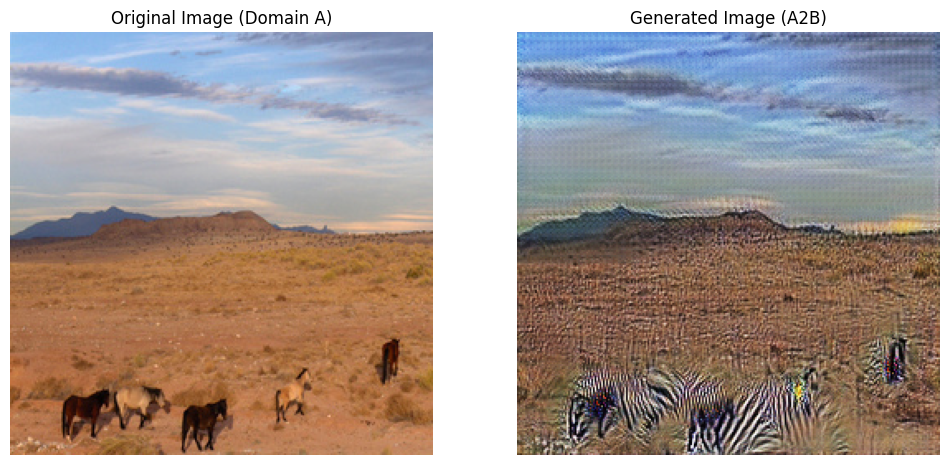

Epoch [24/50] Batch [0/1334] Loss_G: 4.5129 Loss_D_A: 0.1299 Loss_D_B: 0.0673
Epoch [24/50] Batch [100/1334] Loss_G: 3.9645 Loss_D_A: 0.4301 Loss_D_B: 0.0896
Epoch [24/50] Batch [200/1334] Loss_G: 3.6180 Loss_D_A: 0.3444 Loss_D_B: 0.2764
Epoch [24/50] Batch [300/1334] Loss_G: 5.7701 Loss_D_A: 0.1701 Loss_D_B: 0.0588
Epoch [24/50] Batch [400/1334] Loss_G: 3.5964 Loss_D_A: 0.2827 Loss_D_B: 0.2555
Epoch [24/50] Batch [500/1334] Loss_G: 5.2022 Loss_D_A: 0.0370 Loss_D_B: 0.0851
Epoch [24/50] Batch [600/1334] Loss_G: 4.3524 Loss_D_A: 0.2534 Loss_D_B: 0.1012
Epoch [24/50] Batch [700/1334] Loss_G: 3.8343 Loss_D_A: 0.2108 Loss_D_B: 0.0692
Epoch [24/50] Batch [800/1334] Loss_G: 3.8801 Loss_D_A: 0.3327 Loss_D_B: 0.1762
Epoch [24/50] Batch [900/1334] Loss_G: 4.9966 Loss_D_A: 0.0839 Loss_D_B: 0.0359
Epoch [24/50] Batch [1000/1334] Loss_G: 4.7668 Loss_D_A: 0.2147 Loss_D_B: 0.0566
Epoch [24/50] Batch [1100/1334] Loss_G: 5.7985 Loss_D_A: 0.1401 Loss_D_B: 0.1088
Epoch [24/50] Batch [1200/1334] Loss_G: 

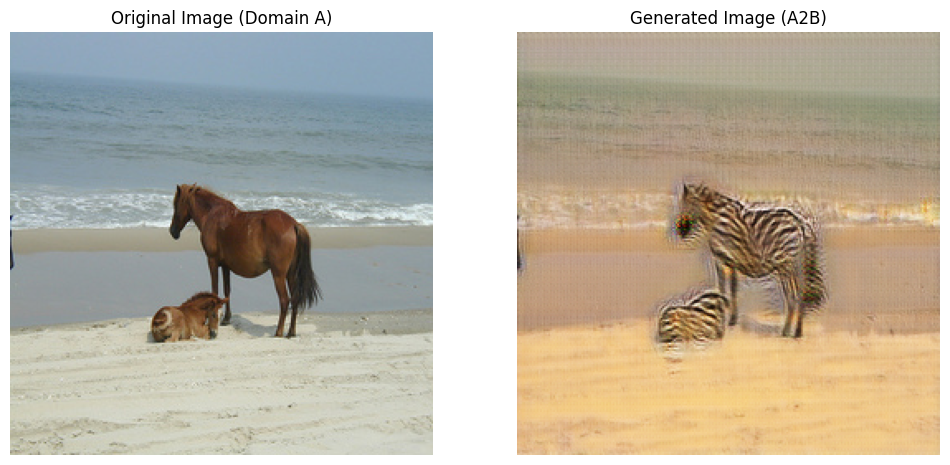

Epoch [25/50] Batch [0/1334] Loss_G: 5.8859 Loss_D_A: 0.0681 Loss_D_B: 0.0825
Epoch [25/50] Batch [100/1334] Loss_G: 4.9545 Loss_D_A: 0.1303 Loss_D_B: 0.0519
Epoch [25/50] Batch [200/1334] Loss_G: 3.9222 Loss_D_A: 0.3601 Loss_D_B: 0.1422
Epoch [25/50] Batch [300/1334] Loss_G: 4.5776 Loss_D_A: 0.1160 Loss_D_B: 0.0936
Epoch [25/50] Batch [400/1334] Loss_G: 4.0171 Loss_D_A: 0.1266 Loss_D_B: 0.1254
Epoch [25/50] Batch [500/1334] Loss_G: 4.8235 Loss_D_A: 0.1629 Loss_D_B: 0.0852
Epoch [25/50] Batch [600/1334] Loss_G: 4.6143 Loss_D_A: 0.1625 Loss_D_B: 0.1072
Epoch [25/50] Batch [700/1334] Loss_G: 5.4455 Loss_D_A: 0.0295 Loss_D_B: 0.0672
Epoch [25/50] Batch [800/1334] Loss_G: 5.4649 Loss_D_A: 0.0571 Loss_D_B: 0.0324
Epoch [25/50] Batch [900/1334] Loss_G: 6.1692 Loss_D_A: 0.2924 Loss_D_B: 0.0694
Epoch [25/50] Batch [1000/1334] Loss_G: 4.3413 Loss_D_A: 0.2950 Loss_D_B: 0.2460
Epoch [25/50] Batch [1100/1334] Loss_G: 4.7888 Loss_D_A: 0.1383 Loss_D_B: 0.1240
Epoch [25/50] Batch [1200/1334] Loss_G: 

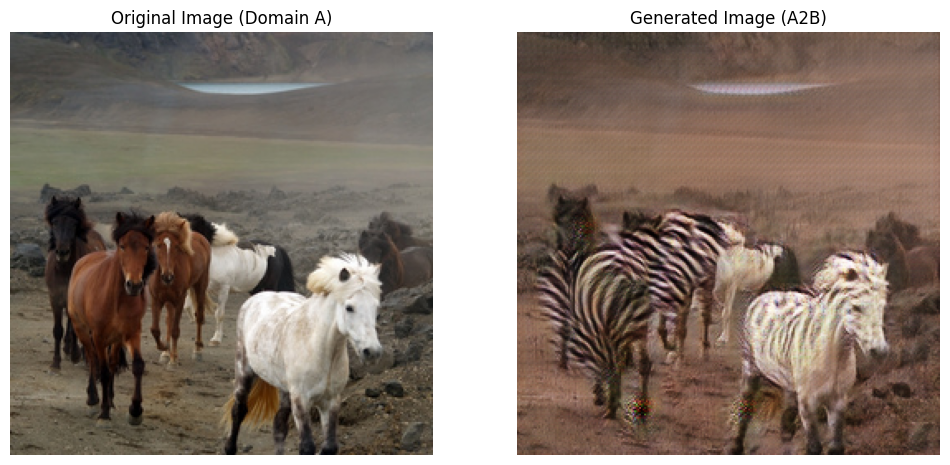

Epoch [26/50] Batch [0/1334] Loss_G: 4.8136 Loss_D_A: 0.0796 Loss_D_B: 0.2267
Epoch [26/50] Batch [100/1334] Loss_G: 4.8321 Loss_D_A: 0.0684 Loss_D_B: 0.1160
Epoch [26/50] Batch [200/1334] Loss_G: 5.4620 Loss_D_A: 0.5042 Loss_D_B: 0.3059
Epoch [26/50] Batch [300/1334] Loss_G: 4.6774 Loss_D_A: 0.0913 Loss_D_B: 0.0284
Epoch [26/50] Batch [400/1334] Loss_G: 3.9751 Loss_D_A: 0.1788 Loss_D_B: 0.1908
Epoch [26/50] Batch [500/1334] Loss_G: 4.2412 Loss_D_A: 0.0957 Loss_D_B: 0.2902
Epoch [26/50] Batch [600/1334] Loss_G: 4.1776 Loss_D_A: 0.0492 Loss_D_B: 0.0761
Epoch [26/50] Batch [700/1334] Loss_G: 3.9018 Loss_D_A: 0.1540 Loss_D_B: 0.1902
Epoch [26/50] Batch [800/1334] Loss_G: 4.6313 Loss_D_A: 0.0680 Loss_D_B: 0.1535
Epoch [26/50] Batch [900/1334] Loss_G: 4.6712 Loss_D_A: 0.2141 Loss_D_B: 0.2740
Epoch [26/50] Batch [1000/1334] Loss_G: 5.2164 Loss_D_A: 0.0926 Loss_D_B: 0.1645
Epoch [26/50] Batch [1100/1334] Loss_G: 4.2531 Loss_D_A: 0.0727 Loss_D_B: 0.0700
Epoch [26/50] Batch [1200/1334] Loss_G: 

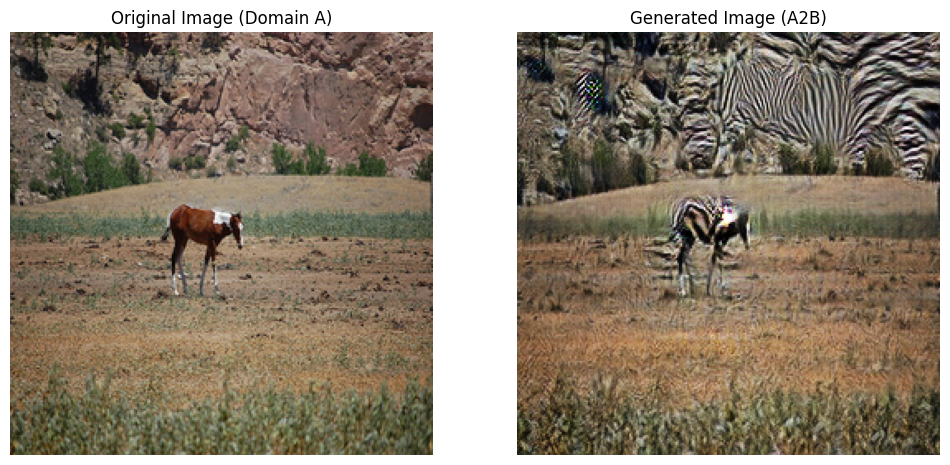

Epoch [27/50] Batch [0/1334] Loss_G: 5.3289 Loss_D_A: 0.0681 Loss_D_B: 0.1199
Epoch [27/50] Batch [100/1334] Loss_G: 3.3847 Loss_D_A: 0.2285 Loss_D_B: 0.1592
Epoch [27/50] Batch [200/1334] Loss_G: 4.8974 Loss_D_A: 0.2029 Loss_D_B: 0.1141
Epoch [27/50] Batch [300/1334] Loss_G: 4.9139 Loss_D_A: 0.1856 Loss_D_B: 0.0924
Epoch [27/50] Batch [400/1334] Loss_G: 4.5182 Loss_D_A: 0.2503 Loss_D_B: 0.1990
Epoch [27/50] Batch [500/1334] Loss_G: 5.9260 Loss_D_A: 0.2080 Loss_D_B: 0.0696
Epoch [27/50] Batch [600/1334] Loss_G: 5.2914 Loss_D_A: 0.0816 Loss_D_B: 0.0562
Epoch [27/50] Batch [700/1334] Loss_G: 4.3790 Loss_D_A: 0.1998 Loss_D_B: 0.1478
Epoch [27/50] Batch [800/1334] Loss_G: 6.3140 Loss_D_A: 0.5324 Loss_D_B: 0.3333
Epoch [27/50] Batch [900/1334] Loss_G: 4.2482 Loss_D_A: 0.1268 Loss_D_B: 0.0759
Epoch [27/50] Batch [1000/1334] Loss_G: 4.6716 Loss_D_A: 0.0328 Loss_D_B: 0.0431
Epoch [27/50] Batch [1100/1334] Loss_G: 4.8897 Loss_D_A: 0.1024 Loss_D_B: 0.2078
Epoch [27/50] Batch [1200/1334] Loss_G: 

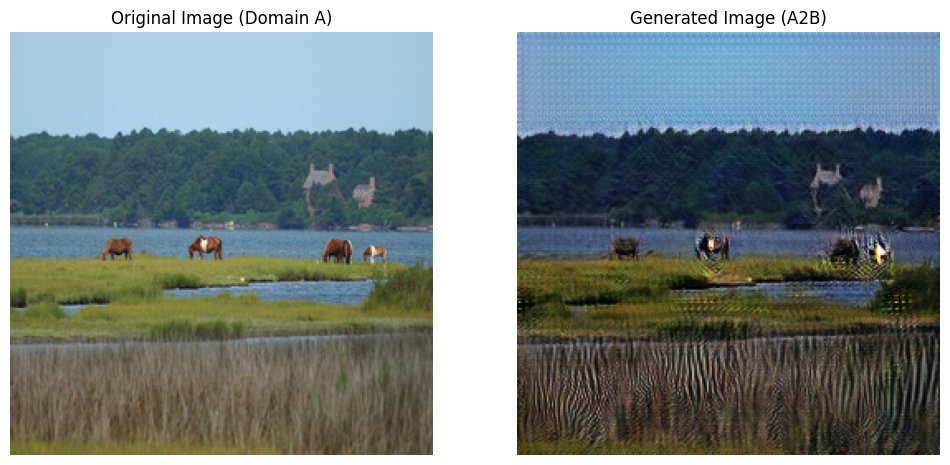

Epoch [28/50] Batch [0/1334] Loss_G: 4.0439 Loss_D_A: 0.2559 Loss_D_B: 0.0854
Epoch [28/50] Batch [100/1334] Loss_G: 3.8246 Loss_D_A: 0.2396 Loss_D_B: 0.2556
Epoch [28/50] Batch [200/1334] Loss_G: 3.7699 Loss_D_A: 0.3538 Loss_D_B: 0.0834
Epoch [28/50] Batch [300/1334] Loss_G: 5.6832 Loss_D_A: 0.2892 Loss_D_B: 0.0820
Epoch [28/50] Batch [400/1334] Loss_G: 5.2746 Loss_D_A: 0.3759 Loss_D_B: 0.1263
Epoch [28/50] Batch [500/1334] Loss_G: 3.6864 Loss_D_A: 0.2913 Loss_D_B: 0.4421
Epoch [28/50] Batch [600/1334] Loss_G: 4.0783 Loss_D_A: 0.0450 Loss_D_B: 0.1475
Epoch [28/50] Batch [700/1334] Loss_G: 4.5967 Loss_D_A: 0.1741 Loss_D_B: 0.1052
Epoch [28/50] Batch [800/1334] Loss_G: 3.4148 Loss_D_A: 0.2455 Loss_D_B: 0.2812
Epoch [28/50] Batch [900/1334] Loss_G: 5.2051 Loss_D_A: 0.0311 Loss_D_B: 0.0389
Epoch [28/50] Batch [1000/1334] Loss_G: 4.0678 Loss_D_A: 0.1631 Loss_D_B: 0.1424
Epoch [28/50] Batch [1100/1334] Loss_G: 5.9334 Loss_D_A: 0.1107 Loss_D_B: 0.0253
Epoch [28/50] Batch [1200/1334] Loss_G: 

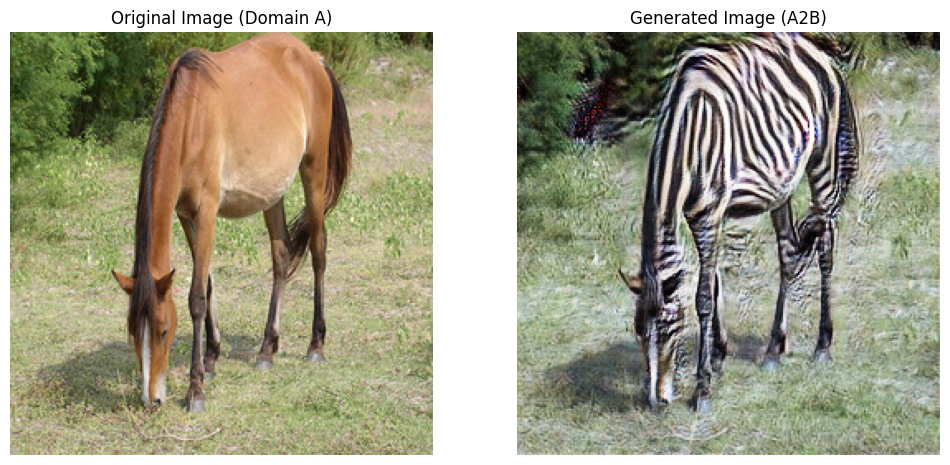

Epoch [29/50] Batch [0/1334] Loss_G: 3.8943 Loss_D_A: 0.1102 Loss_D_B: 0.0697
Epoch [29/50] Batch [100/1334] Loss_G: 4.3355 Loss_D_A: 0.1267 Loss_D_B: 0.2324
Epoch [29/50] Batch [200/1334] Loss_G: 5.0942 Loss_D_A: 0.0640 Loss_D_B: 0.2641
Epoch [29/50] Batch [300/1334] Loss_G: 3.7650 Loss_D_A: 0.3007 Loss_D_B: 0.2014
Epoch [29/50] Batch [400/1334] Loss_G: 4.1656 Loss_D_A: 0.1445 Loss_D_B: 0.1353
Epoch [29/50] Batch [500/1334] Loss_G: 3.8454 Loss_D_A: 0.1118 Loss_D_B: 0.1783
Epoch [29/50] Batch [600/1334] Loss_G: 5.8269 Loss_D_A: 0.1918 Loss_D_B: 0.1384
Epoch [29/50] Batch [700/1334] Loss_G: 4.4314 Loss_D_A: 0.2712 Loss_D_B: 0.1116
Epoch [29/50] Batch [800/1334] Loss_G: 4.4160 Loss_D_A: 0.1526 Loss_D_B: 0.0806
Epoch [29/50] Batch [900/1334] Loss_G: 4.4147 Loss_D_A: 0.1132 Loss_D_B: 0.0893
Epoch [29/50] Batch [1000/1334] Loss_G: 5.8772 Loss_D_A: 0.2141 Loss_D_B: 0.1092
Epoch [29/50] Batch [1100/1334] Loss_G: 4.9225 Loss_D_A: 0.0527 Loss_D_B: 0.1387
Epoch [29/50] Batch [1200/1334] Loss_G: 

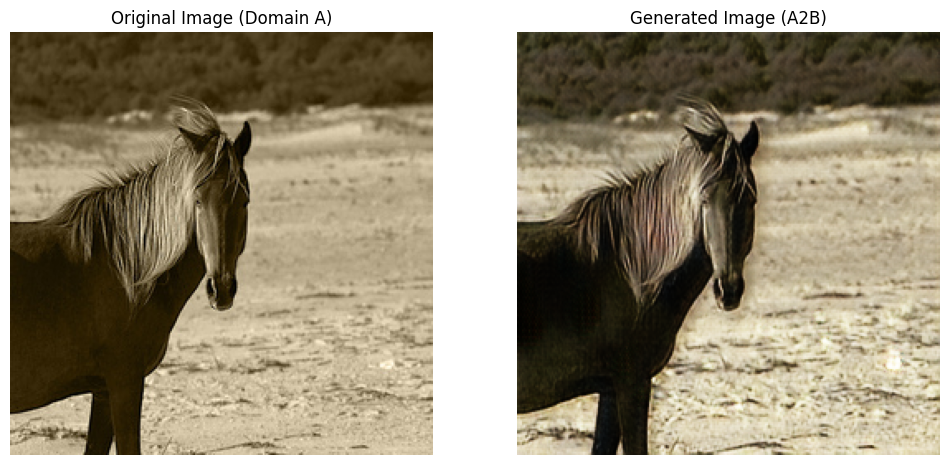

Epoch [30/50] Batch [0/1334] Loss_G: 4.6698 Loss_D_A: 0.2015 Loss_D_B: 0.2362
Epoch [30/50] Batch [100/1334] Loss_G: 5.1760 Loss_D_A: 0.2476 Loss_D_B: 0.2717
Epoch [30/50] Batch [200/1334] Loss_G: 5.2010 Loss_D_A: 0.0826 Loss_D_B: 0.0889
Epoch [30/50] Batch [300/1334] Loss_G: 5.5216 Loss_D_A: 0.0806 Loss_D_B: 0.1099
Epoch [30/50] Batch [400/1334] Loss_G: 4.5475 Loss_D_A: 0.0556 Loss_D_B: 0.0290
Epoch [30/50] Batch [500/1334] Loss_G: 4.3578 Loss_D_A: 0.1844 Loss_D_B: 0.1026
Epoch [30/50] Batch [600/1334] Loss_G: 5.1951 Loss_D_A: 0.2051 Loss_D_B: 0.0649
Epoch [30/50] Batch [700/1334] Loss_G: 4.9958 Loss_D_A: 0.0611 Loss_D_B: 0.0937
Epoch [30/50] Batch [800/1334] Loss_G: 3.1279 Loss_D_A: 0.1893 Loss_D_B: 0.2561
Epoch [30/50] Batch [900/1334] Loss_G: 4.6299 Loss_D_A: 0.3171 Loss_D_B: 0.1084
Epoch [30/50] Batch [1000/1334] Loss_G: 4.8367 Loss_D_A: 0.1239 Loss_D_B: 0.1333
Epoch [30/50] Batch [1100/1334] Loss_G: 5.0542 Loss_D_A: 0.1174 Loss_D_B: 0.1132
Epoch [30/50] Batch [1200/1334] Loss_G: 

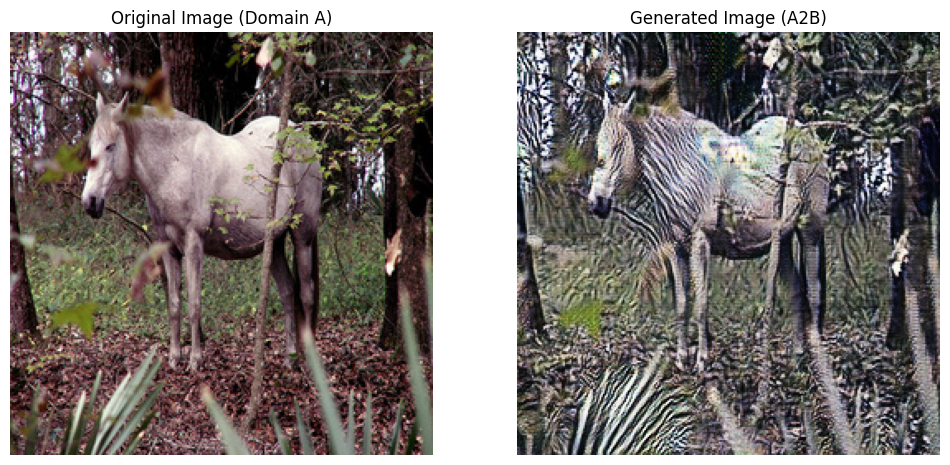

Epoch [31/50] Batch [0/1334] Loss_G: 4.3785 Loss_D_A: 0.1290 Loss_D_B: 0.1707
Epoch [31/50] Batch [100/1334] Loss_G: 3.2789 Loss_D_A: 0.2449 Loss_D_B: 0.1015
Epoch [31/50] Batch [200/1334] Loss_G: 5.1264 Loss_D_A: 0.1762 Loss_D_B: 0.1744
Epoch [31/50] Batch [300/1334] Loss_G: 3.7633 Loss_D_A: 0.3201 Loss_D_B: 0.3494
Epoch [31/50] Batch [400/1334] Loss_G: 4.2164 Loss_D_A: 0.2126 Loss_D_B: 0.0954
Epoch [31/50] Batch [500/1334] Loss_G: 4.4859 Loss_D_A: 0.2354 Loss_D_B: 0.0689
Epoch [31/50] Batch [600/1334] Loss_G: 4.9106 Loss_D_A: 0.1786 Loss_D_B: 0.1229
Epoch [31/50] Batch [700/1334] Loss_G: 4.0065 Loss_D_A: 0.2047 Loss_D_B: 0.0657
Epoch [31/50] Batch [800/1334] Loss_G: 3.9651 Loss_D_A: 0.2263 Loss_D_B: 0.0560
Epoch [31/50] Batch [900/1334] Loss_G: 3.9504 Loss_D_A: 0.2095 Loss_D_B: 0.1285
Epoch [31/50] Batch [1000/1334] Loss_G: 5.5457 Loss_D_A: 0.1852 Loss_D_B: 0.0838
Epoch [31/50] Batch [1100/1334] Loss_G: 4.6262 Loss_D_A: 0.2845 Loss_D_B: 0.1451
Epoch [31/50] Batch [1200/1334] Loss_G: 

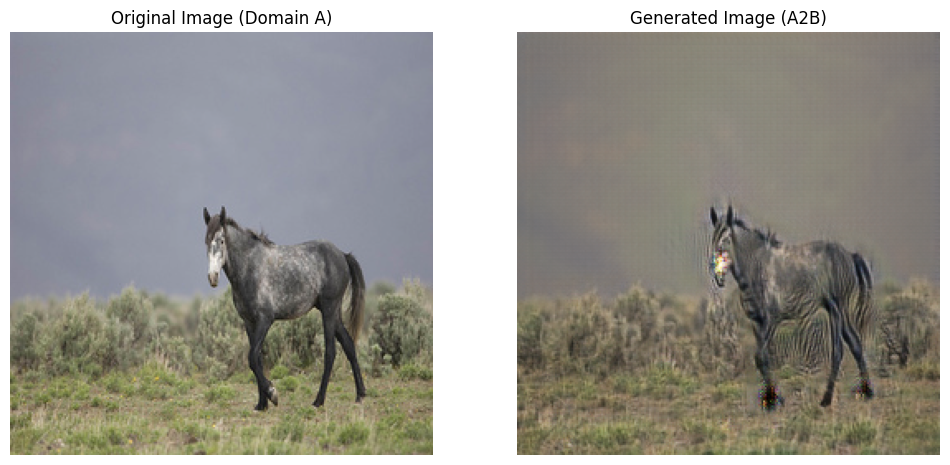

Epoch [32/50] Batch [0/1334] Loss_G: 4.4853 Loss_D_A: 0.1143 Loss_D_B: 0.3297
Epoch [32/50] Batch [100/1334] Loss_G: 3.3434 Loss_D_A: 0.1214 Loss_D_B: 0.1608
Epoch [32/50] Batch [200/1334] Loss_G: 4.4067 Loss_D_A: 0.4131 Loss_D_B: 0.1157
Epoch [32/50] Batch [300/1334] Loss_G: 4.8342 Loss_D_A: 0.1135 Loss_D_B: 0.0401
Epoch [32/50] Batch [400/1334] Loss_G: 3.7425 Loss_D_A: 0.0556 Loss_D_B: 0.1035
Epoch [32/50] Batch [500/1334] Loss_G: 3.7325 Loss_D_A: 0.0666 Loss_D_B: 0.1024
Epoch [32/50] Batch [600/1334] Loss_G: 5.5352 Loss_D_A: 0.3380 Loss_D_B: 0.0999
Epoch [32/50] Batch [700/1334] Loss_G: 3.1529 Loss_D_A: 0.2894 Loss_D_B: 0.2928
Epoch [32/50] Batch [800/1334] Loss_G: 3.8369 Loss_D_A: 0.1117 Loss_D_B: 0.0765
Epoch [32/50] Batch [900/1334] Loss_G: 5.2877 Loss_D_A: 0.1403 Loss_D_B: 0.2244
Epoch [32/50] Batch [1000/1334] Loss_G: 3.5486 Loss_D_A: 0.5395 Loss_D_B: 0.3839
Epoch [32/50] Batch [1100/1334] Loss_G: 4.3518 Loss_D_A: 0.1350 Loss_D_B: 0.1422
Epoch [32/50] Batch [1200/1334] Loss_G: 

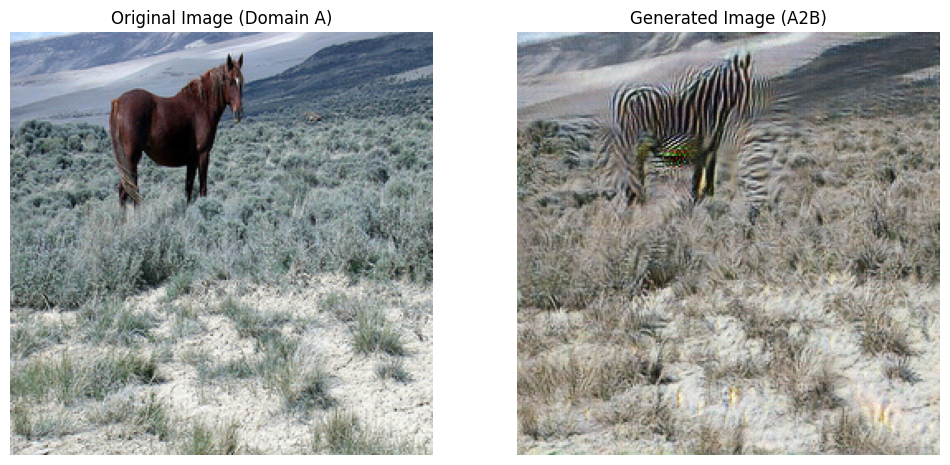

Epoch [33/50] Batch [0/1334] Loss_G: 4.4857 Loss_D_A: 0.3172 Loss_D_B: 0.0887
Epoch [33/50] Batch [100/1334] Loss_G: 4.1095 Loss_D_A: 0.0608 Loss_D_B: 0.0802
Epoch [33/50] Batch [200/1334] Loss_G: 4.8697 Loss_D_A: 0.1424 Loss_D_B: 0.1251
Epoch [33/50] Batch [300/1334] Loss_G: 3.3238 Loss_D_A: 0.1122 Loss_D_B: 0.1877
Epoch [33/50] Batch [400/1334] Loss_G: 4.4650 Loss_D_A: 0.1523 Loss_D_B: 0.0633
Epoch [33/50] Batch [500/1334] Loss_G: 4.4021 Loss_D_A: 0.2997 Loss_D_B: 0.1439
Epoch [33/50] Batch [600/1334] Loss_G: 7.3106 Loss_D_A: 0.2039 Loss_D_B: 0.1823
Epoch [33/50] Batch [700/1334] Loss_G: 4.7086 Loss_D_A: 0.1978 Loss_D_B: 0.0926
Epoch [33/50] Batch [800/1334] Loss_G: 3.7540 Loss_D_A: 0.2241 Loss_D_B: 0.1450
Epoch [33/50] Batch [900/1334] Loss_G: 3.4883 Loss_D_A: 0.4151 Loss_D_B: 0.1896
Epoch [33/50] Batch [1000/1334] Loss_G: 3.8695 Loss_D_A: 0.1079 Loss_D_B: 0.0881
Epoch [33/50] Batch [1100/1334] Loss_G: 5.8950 Loss_D_A: 0.0894 Loss_D_B: 0.1694
Epoch [33/50] Batch [1200/1334] Loss_G: 

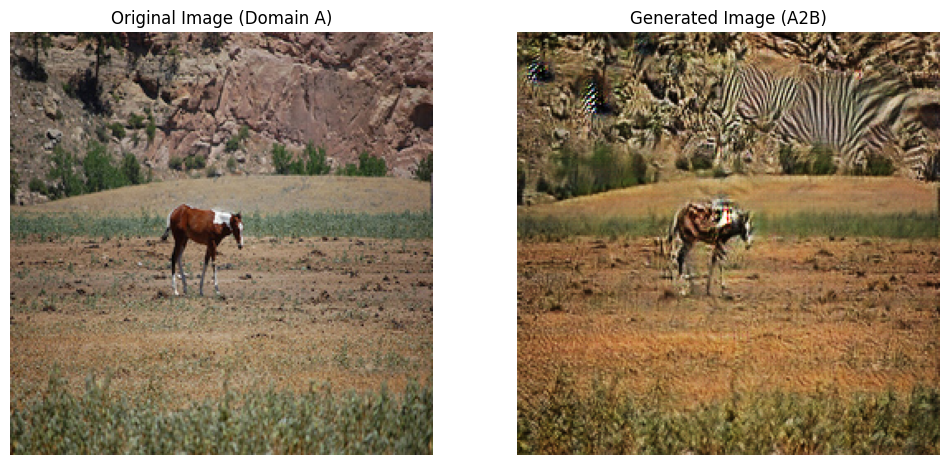

Epoch [34/50] Batch [0/1334] Loss_G: 4.9633 Loss_D_A: 0.1438 Loss_D_B: 0.1042
Epoch [34/50] Batch [100/1334] Loss_G: 5.5320 Loss_D_A: 0.0855 Loss_D_B: 0.1485
Epoch [34/50] Batch [200/1334] Loss_G: 4.5991 Loss_D_A: 0.2252 Loss_D_B: 0.1340
Epoch [34/50] Batch [300/1334] Loss_G: 5.5939 Loss_D_A: 0.4009 Loss_D_B: 0.1234
Epoch [34/50] Batch [400/1334] Loss_G: 4.4380 Loss_D_A: 0.0686 Loss_D_B: 0.0499
Epoch [34/50] Batch [500/1334] Loss_G: 4.3590 Loss_D_A: 0.1075 Loss_D_B: 0.0477
Epoch [34/50] Batch [600/1334] Loss_G: 4.6153 Loss_D_A: 0.0683 Loss_D_B: 0.0754
Epoch [34/50] Batch [700/1334] Loss_G: 4.1580 Loss_D_A: 0.1344 Loss_D_B: 0.2315
Epoch [34/50] Batch [800/1334] Loss_G: 4.1645 Loss_D_A: 0.1790 Loss_D_B: 0.0991
Epoch [34/50] Batch [900/1334] Loss_G: 4.2560 Loss_D_A: 0.1206 Loss_D_B: 0.1534
Epoch [34/50] Batch [1000/1334] Loss_G: 5.1735 Loss_D_A: 0.2097 Loss_D_B: 0.2119
Epoch [34/50] Batch [1100/1334] Loss_G: 5.4220 Loss_D_A: 0.0698 Loss_D_B: 0.1396
Epoch [34/50] Batch [1200/1334] Loss_G: 

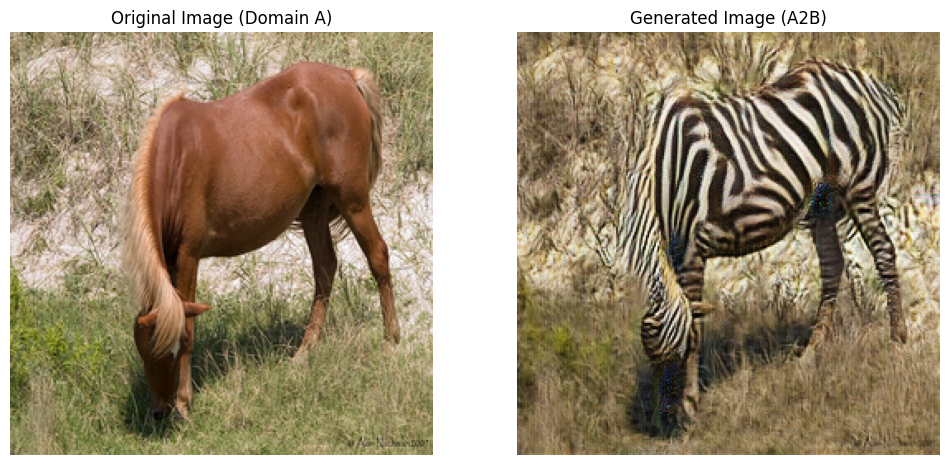

Epoch [35/50] Batch [0/1334] Loss_G: 4.5189 Loss_D_A: 0.0910 Loss_D_B: 0.1339
Epoch [35/50] Batch [100/1334] Loss_G: 5.0056 Loss_D_A: 0.2425 Loss_D_B: 0.1202
Epoch [35/50] Batch [200/1334] Loss_G: 3.7396 Loss_D_A: 0.2040 Loss_D_B: 0.1154
Epoch [35/50] Batch [300/1334] Loss_G: 3.7818 Loss_D_A: 0.2479 Loss_D_B: 0.2368
Epoch [35/50] Batch [400/1334] Loss_G: 5.1167 Loss_D_A: 0.4055 Loss_D_B: 0.2912
Epoch [35/50] Batch [500/1334] Loss_G: 3.7804 Loss_D_A: 0.2443 Loss_D_B: 0.0786
Epoch [35/50] Batch [600/1334] Loss_G: 4.9418 Loss_D_A: 0.0727 Loss_D_B: 0.0818
Epoch [35/50] Batch [700/1334] Loss_G: 4.3547 Loss_D_A: 0.1042 Loss_D_B: 0.0312
Epoch [35/50] Batch [800/1334] Loss_G: 4.5919 Loss_D_A: 0.0889 Loss_D_B: 0.1931
Epoch [35/50] Batch [900/1334] Loss_G: 4.0270 Loss_D_A: 0.0698 Loss_D_B: 0.3319
Epoch [35/50] Batch [1000/1334] Loss_G: 3.5761 Loss_D_A: 0.2393 Loss_D_B: 0.2379
Epoch [35/50] Batch [1100/1334] Loss_G: 4.8209 Loss_D_A: 0.1453 Loss_D_B: 0.0390
Epoch [35/50] Batch [1200/1334] Loss_G: 

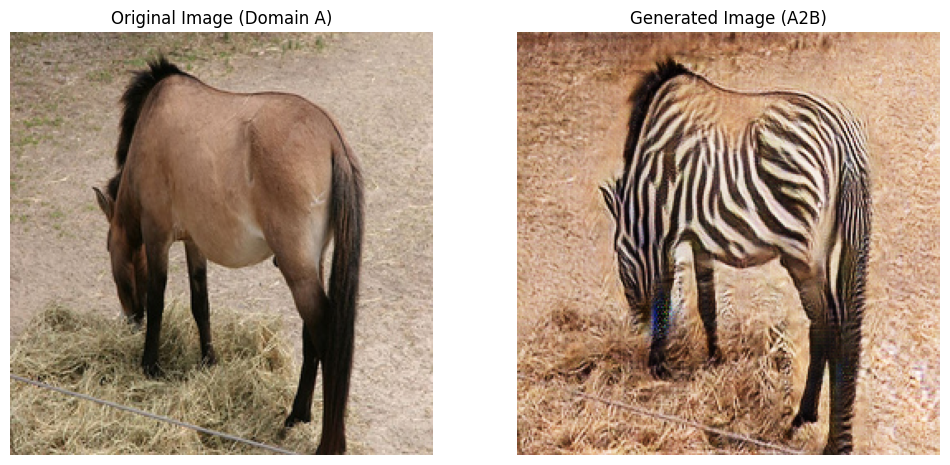

Epoch [36/50] Batch [0/1334] Loss_G: 3.9305 Loss_D_A: 0.1393 Loss_D_B: 0.0389
Epoch [36/50] Batch [100/1334] Loss_G: 4.1124 Loss_D_A: 0.0621 Loss_D_B: 0.0496
Epoch [36/50] Batch [200/1334] Loss_G: 5.3507 Loss_D_A: 0.2208 Loss_D_B: 0.0857
Epoch [36/50] Batch [300/1334] Loss_G: 4.0865 Loss_D_A: 0.2271 Loss_D_B: 0.1226
Epoch [36/50] Batch [400/1334] Loss_G: 4.2145 Loss_D_A: 0.0747 Loss_D_B: 0.0817
Epoch [36/50] Batch [500/1334] Loss_G: 3.4795 Loss_D_A: 0.1771 Loss_D_B: 0.3000
Epoch [36/50] Batch [600/1334] Loss_G: 4.0195 Loss_D_A: 0.1483 Loss_D_B: 0.0903
Epoch [36/50] Batch [700/1334] Loss_G: 4.6193 Loss_D_A: 0.0852 Loss_D_B: 0.1231
Epoch [36/50] Batch [800/1334] Loss_G: 3.9517 Loss_D_A: 0.1818 Loss_D_B: 0.2142
Epoch [36/50] Batch [900/1334] Loss_G: 5.2025 Loss_D_A: 0.1621 Loss_D_B: 0.0850
Epoch [36/50] Batch [1000/1334] Loss_G: 4.2464 Loss_D_A: 0.1935 Loss_D_B: 0.1514
Epoch [36/50] Batch [1100/1334] Loss_G: 3.8313 Loss_D_A: 0.3095 Loss_D_B: 0.3011
Epoch [36/50] Batch [1200/1334] Loss_G: 

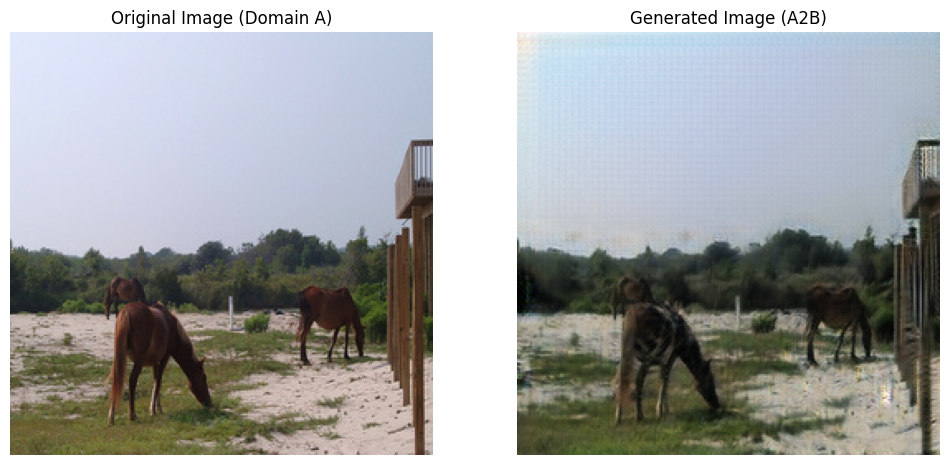

Epoch [37/50] Batch [0/1334] Loss_G: 6.1862 Loss_D_A: 0.0626 Loss_D_B: 0.1386
Epoch [37/50] Batch [100/1334] Loss_G: 4.0530 Loss_D_A: 0.3472 Loss_D_B: 0.1771
Epoch [37/50] Batch [200/1334] Loss_G: 3.2693 Loss_D_A: 0.2022 Loss_D_B: 0.2563
Epoch [37/50] Batch [300/1334] Loss_G: 4.3726 Loss_D_A: 0.1729 Loss_D_B: 0.3909
Epoch [37/50] Batch [400/1334] Loss_G: 4.5535 Loss_D_A: 0.2298 Loss_D_B: 0.1818
Epoch [37/50] Batch [500/1334] Loss_G: 4.6311 Loss_D_A: 0.1968 Loss_D_B: 0.0862
Epoch [37/50] Batch [600/1334] Loss_G: 5.0048 Loss_D_A: 0.1112 Loss_D_B: 0.1554
Epoch [37/50] Batch [700/1334] Loss_G: 2.9158 Loss_D_A: 0.4713 Loss_D_B: 0.4650
Epoch [37/50] Batch [800/1334] Loss_G: 4.4833 Loss_D_A: 0.1552 Loss_D_B: 0.1108
Epoch [37/50] Batch [900/1334] Loss_G: 3.5750 Loss_D_A: 0.0716 Loss_D_B: 0.0987
Epoch [37/50] Batch [1000/1334] Loss_G: 3.2467 Loss_D_A: 0.2413 Loss_D_B: 0.3177
Epoch [37/50] Batch [1100/1334] Loss_G: 4.3234 Loss_D_A: 0.1866 Loss_D_B: 0.1140
Epoch [37/50] Batch [1200/1334] Loss_G: 

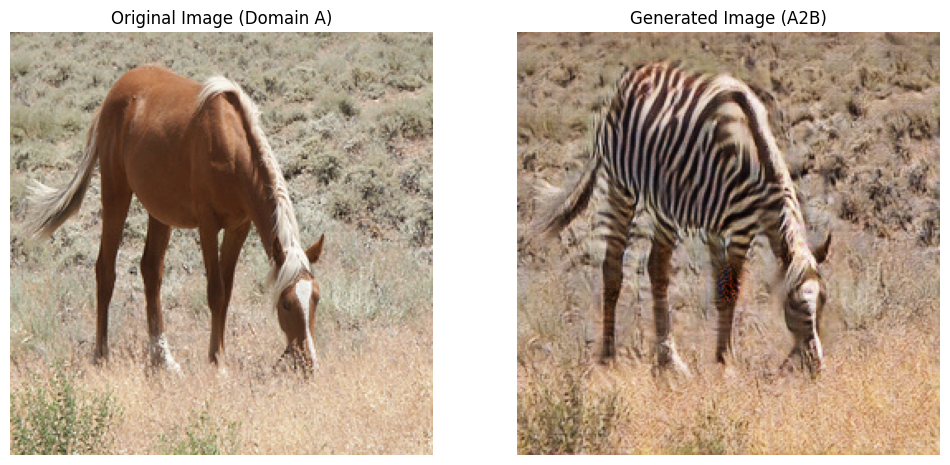

Epoch [38/50] Batch [0/1334] Loss_G: 4.6417 Loss_D_A: 0.0480 Loss_D_B: 0.1531
Epoch [38/50] Batch [100/1334] Loss_G: 4.6024 Loss_D_A: 0.1367 Loss_D_B: 0.1534
Epoch [38/50] Batch [200/1334] Loss_G: 3.9951 Loss_D_A: 0.1355 Loss_D_B: 0.0477
Epoch [38/50] Batch [300/1334] Loss_G: 3.9820 Loss_D_A: 0.1390 Loss_D_B: 0.1081
Epoch [38/50] Batch [400/1334] Loss_G: 2.9572 Loss_D_A: 0.3024 Loss_D_B: 0.2823
Epoch [38/50] Batch [500/1334] Loss_G: 4.8291 Loss_D_A: 0.1286 Loss_D_B: 0.0796
Epoch [38/50] Batch [600/1334] Loss_G: 4.2270 Loss_D_A: 0.3071 Loss_D_B: 0.0554
Epoch [38/50] Batch [700/1334] Loss_G: 4.5717 Loss_D_A: 0.0372 Loss_D_B: 0.0977
Epoch [38/50] Batch [800/1334] Loss_G: 4.8463 Loss_D_A: 0.1029 Loss_D_B: 0.1377
Epoch [38/50] Batch [900/1334] Loss_G: 4.3035 Loss_D_A: 0.0435 Loss_D_B: 0.0399
Epoch [38/50] Batch [1000/1334] Loss_G: 4.4071 Loss_D_A: 0.1883 Loss_D_B: 0.1226
Epoch [38/50] Batch [1100/1334] Loss_G: 4.5646 Loss_D_A: 0.1390 Loss_D_B: 0.0875
Epoch [38/50] Batch [1200/1334] Loss_G: 

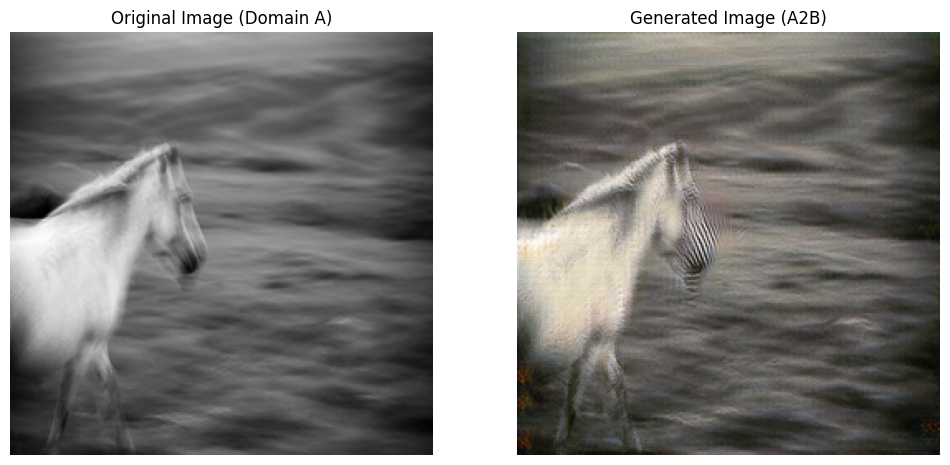

Epoch [39/50] Batch [0/1334] Loss_G: 3.3025 Loss_D_A: 0.1818 Loss_D_B: 0.1241
Epoch [39/50] Batch [100/1334] Loss_G: 5.5544 Loss_D_A: 0.1416 Loss_D_B: 0.1485
Epoch [39/50] Batch [200/1334] Loss_G: 4.2026 Loss_D_A: 0.1505 Loss_D_B: 0.1004
Epoch [39/50] Batch [300/1334] Loss_G: 6.1113 Loss_D_A: 0.1798 Loss_D_B: 0.0579
Epoch [39/50] Batch [400/1334] Loss_G: 4.5649 Loss_D_A: 0.2133 Loss_D_B: 0.2171
Epoch [39/50] Batch [500/1334] Loss_G: 3.9047 Loss_D_A: 0.2337 Loss_D_B: 0.0587
Epoch [39/50] Batch [600/1334] Loss_G: 3.5340 Loss_D_A: 0.1227 Loss_D_B: 0.0601
Epoch [39/50] Batch [700/1334] Loss_G: 4.7553 Loss_D_A: 0.1354 Loss_D_B: 0.0729
Epoch [39/50] Batch [800/1334] Loss_G: 4.3597 Loss_D_A: 0.0829 Loss_D_B: 0.1138
Epoch [39/50] Batch [900/1334] Loss_G: 4.1770 Loss_D_A: 0.1032 Loss_D_B: 0.1650
Epoch [39/50] Batch [1000/1334] Loss_G: 4.3350 Loss_D_A: 0.1874 Loss_D_B: 0.1109
Epoch [39/50] Batch [1100/1334] Loss_G: 3.6596 Loss_D_A: 0.2099 Loss_D_B: 0.1565
Epoch [39/50] Batch [1200/1334] Loss_G: 

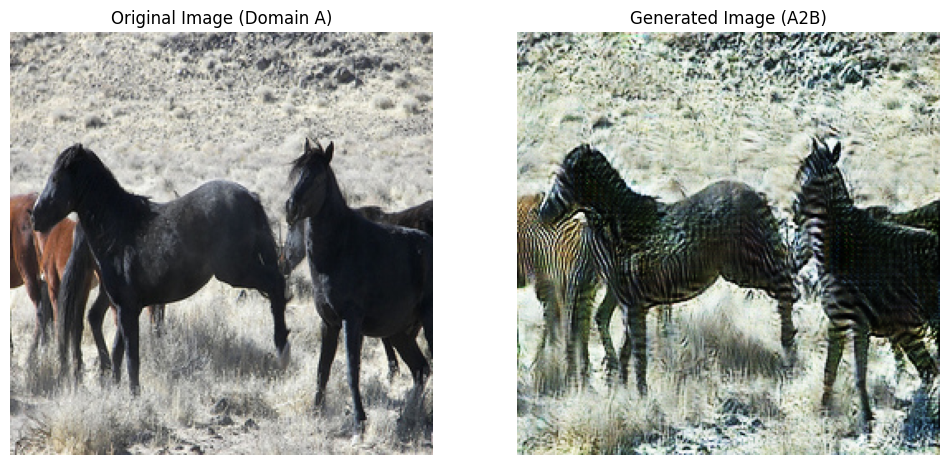

Epoch [40/50] Batch [0/1334] Loss_G: 3.8356 Loss_D_A: 0.1391 Loss_D_B: 0.1839
Epoch [40/50] Batch [100/1334] Loss_G: 3.9915 Loss_D_A: 0.1427 Loss_D_B: 0.1698
Epoch [40/50] Batch [200/1334] Loss_G: 4.7714 Loss_D_A: 0.2557 Loss_D_B: 0.2783
Epoch [40/50] Batch [300/1334] Loss_G: 4.5024 Loss_D_A: 0.0827 Loss_D_B: 0.1056
Epoch [40/50] Batch [400/1334] Loss_G: 3.1976 Loss_D_A: 0.2595 Loss_D_B: 0.1491
Epoch [40/50] Batch [500/1334] Loss_G: 4.3719 Loss_D_A: 0.2141 Loss_D_B: 0.1281
Epoch [40/50] Batch [600/1334] Loss_G: 4.5238 Loss_D_A: 0.0737 Loss_D_B: 0.0247
Epoch [40/50] Batch [700/1334] Loss_G: 4.6993 Loss_D_A: 0.0643 Loss_D_B: 0.1183
Epoch [40/50] Batch [800/1334] Loss_G: 3.5035 Loss_D_A: 0.1349 Loss_D_B: 0.2570
Epoch [40/50] Batch [900/1334] Loss_G: 4.1037 Loss_D_A: 0.1295 Loss_D_B: 0.0704
Epoch [40/50] Batch [1000/1334] Loss_G: 4.8330 Loss_D_A: 0.1209 Loss_D_B: 0.0360
Epoch [40/50] Batch [1100/1334] Loss_G: 3.9107 Loss_D_A: 0.2019 Loss_D_B: 0.0431
Epoch [40/50] Batch [1200/1334] Loss_G: 

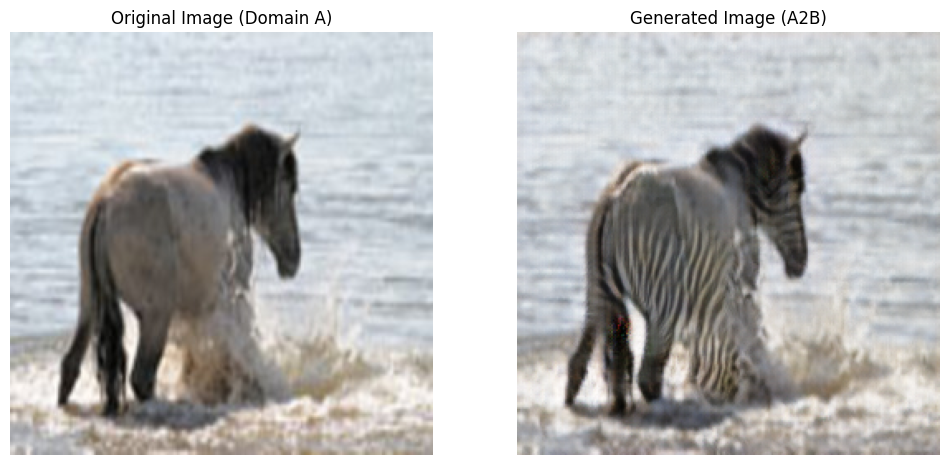

Epoch [41/50] Batch [0/1334] Loss_G: 5.1713 Loss_D_A: 0.1207 Loss_D_B: 0.0519
Epoch [41/50] Batch [100/1334] Loss_G: 4.6014 Loss_D_A: 0.1087 Loss_D_B: 0.0784
Epoch [41/50] Batch [200/1334] Loss_G: 4.9446 Loss_D_A: 0.1765 Loss_D_B: 0.0421
Epoch [41/50] Batch [300/1334] Loss_G: 3.1924 Loss_D_A: 0.1684 Loss_D_B: 0.1118
Epoch [41/50] Batch [400/1334] Loss_G: 3.3375 Loss_D_A: 0.1058 Loss_D_B: 0.1998
Epoch [41/50] Batch [500/1334] Loss_G: 3.7167 Loss_D_A: 0.2017 Loss_D_B: 0.1478
Epoch [41/50] Batch [600/1334] Loss_G: 4.9890 Loss_D_A: 0.1487 Loss_D_B: 0.2115
Epoch [41/50] Batch [700/1334] Loss_G: 5.9251 Loss_D_A: 0.0885 Loss_D_B: 0.0609
Epoch [41/50] Batch [800/1334] Loss_G: 3.9117 Loss_D_A: 0.1445 Loss_D_B: 0.0899
Epoch [41/50] Batch [900/1334] Loss_G: 4.8230 Loss_D_A: 0.4725 Loss_D_B: 0.4270
Epoch [41/50] Batch [1000/1334] Loss_G: 4.8847 Loss_D_A: 0.0628 Loss_D_B: 0.1417
Epoch [41/50] Batch [1100/1334] Loss_G: 3.5069 Loss_D_A: 0.2977 Loss_D_B: 0.1560
Epoch [41/50] Batch [1200/1334] Loss_G: 

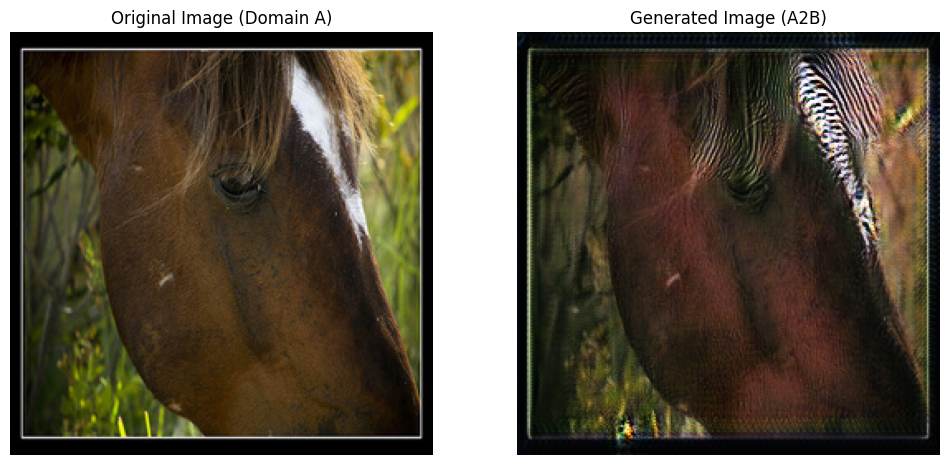

Epoch [42/50] Batch [0/1334] Loss_G: 5.2406 Loss_D_A: 0.2665 Loss_D_B: 0.0846
Epoch [42/50] Batch [100/1334] Loss_G: 4.4672 Loss_D_A: 0.0624 Loss_D_B: 0.0469
Epoch [42/50] Batch [200/1334] Loss_G: 3.9443 Loss_D_A: 0.3395 Loss_D_B: 0.3674
Epoch [42/50] Batch [300/1334] Loss_G: 3.9016 Loss_D_A: 0.1718 Loss_D_B: 0.3942
Epoch [42/50] Batch [400/1334] Loss_G: 3.8154 Loss_D_A: 0.0694 Loss_D_B: 0.0699
Epoch [42/50] Batch [500/1334] Loss_G: 4.3042 Loss_D_A: 0.1251 Loss_D_B: 0.0308
Epoch [42/50] Batch [600/1334] Loss_G: 4.2834 Loss_D_A: 0.1134 Loss_D_B: 0.0410
Epoch [42/50] Batch [700/1334] Loss_G: 4.7530 Loss_D_A: 0.1112 Loss_D_B: 0.1166
Epoch [42/50] Batch [800/1334] Loss_G: 4.1029 Loss_D_A: 0.1199 Loss_D_B: 0.1153
Epoch [42/50] Batch [900/1334] Loss_G: 3.5234 Loss_D_A: 0.1807 Loss_D_B: 0.1206
Epoch [42/50] Batch [1000/1334] Loss_G: 4.8840 Loss_D_A: 0.0367 Loss_D_B: 0.1317
Epoch [42/50] Batch [1100/1334] Loss_G: 3.9309 Loss_D_A: 0.1404 Loss_D_B: 0.1142
Epoch [42/50] Batch [1200/1334] Loss_G: 

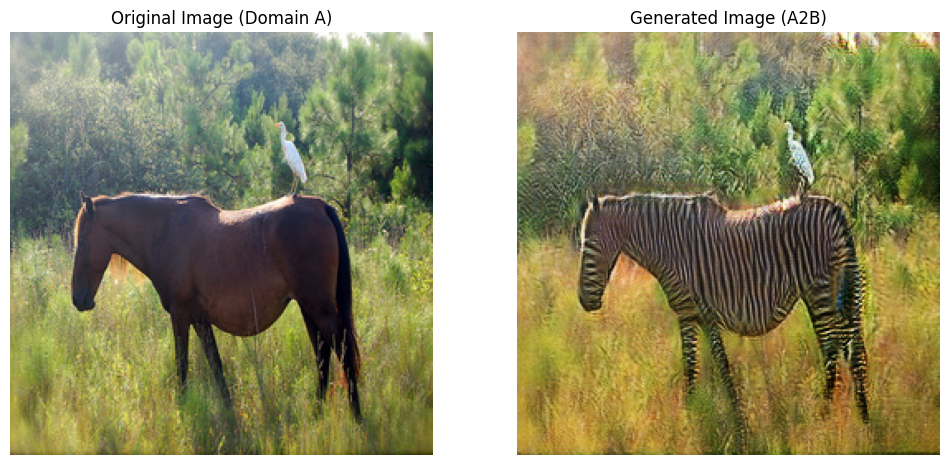

Epoch [43/50] Batch [0/1334] Loss_G: 4.4703 Loss_D_A: 0.0388 Loss_D_B: 0.1522
Epoch [43/50] Batch [100/1334] Loss_G: 3.2902 Loss_D_A: 0.1411 Loss_D_B: 0.2748
Epoch [43/50] Batch [200/1334] Loss_G: 3.8725 Loss_D_A: 0.1156 Loss_D_B: 0.3233
Epoch [43/50] Batch [300/1334] Loss_G: 3.9599 Loss_D_A: 0.3456 Loss_D_B: 0.1380
Epoch [43/50] Batch [400/1334] Loss_G: 3.1486 Loss_D_A: 0.1187 Loss_D_B: 0.1993
Epoch [43/50] Batch [500/1334] Loss_G: 4.4808 Loss_D_A: 0.1184 Loss_D_B: 0.0599
Epoch [43/50] Batch [600/1334] Loss_G: 4.3941 Loss_D_A: 0.1807 Loss_D_B: 0.1145
Epoch [43/50] Batch [700/1334] Loss_G: 4.2855 Loss_D_A: 0.0868 Loss_D_B: 0.0383
Epoch [43/50] Batch [800/1334] Loss_G: 4.0257 Loss_D_A: 0.0991 Loss_D_B: 0.1625
Epoch [43/50] Batch [900/1334] Loss_G: 4.6965 Loss_D_A: 0.0367 Loss_D_B: 0.0796
Epoch [43/50] Batch [1000/1334] Loss_G: 2.9778 Loss_D_A: 0.1581 Loss_D_B: 0.1576
Epoch [43/50] Batch [1100/1334] Loss_G: 3.9999 Loss_D_A: 0.1837 Loss_D_B: 0.4577
Epoch [43/50] Batch [1200/1334] Loss_G: 

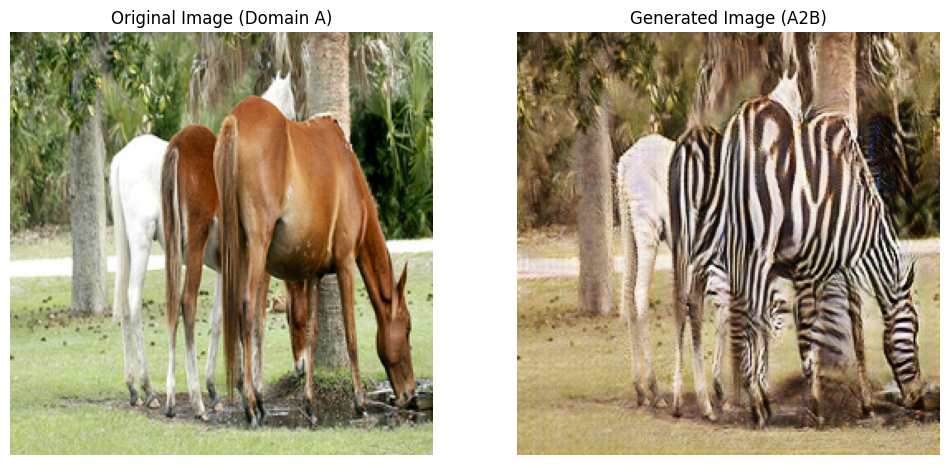

Epoch [44/50] Batch [0/1334] Loss_G: 4.8623 Loss_D_A: 0.0698 Loss_D_B: 0.1274
Epoch [44/50] Batch [100/1334] Loss_G: 4.1318 Loss_D_A: 0.1986 Loss_D_B: 0.1688
Epoch [44/50] Batch [200/1334] Loss_G: 4.0044 Loss_D_A: 0.1249 Loss_D_B: 0.1741
Epoch [44/50] Batch [300/1334] Loss_G: 4.3701 Loss_D_A: 0.1002 Loss_D_B: 0.1466
Epoch [44/50] Batch [400/1334] Loss_G: 4.9079 Loss_D_A: 0.0531 Loss_D_B: 0.1377
Epoch [44/50] Batch [500/1334] Loss_G: 3.7448 Loss_D_A: 0.0766 Loss_D_B: 0.1109
Epoch [44/50] Batch [600/1334] Loss_G: 3.8889 Loss_D_A: 0.1263 Loss_D_B: 0.1417
Epoch [44/50] Batch [700/1334] Loss_G: 5.1518 Loss_D_A: 0.1871 Loss_D_B: 0.0422
Epoch [44/50] Batch [800/1334] Loss_G: 3.1259 Loss_D_A: 0.4996 Loss_D_B: 0.2476
Epoch [44/50] Batch [900/1334] Loss_G: 4.1037 Loss_D_A: 0.1468 Loss_D_B: 0.0508
Epoch [44/50] Batch [1000/1334] Loss_G: 3.7233 Loss_D_A: 0.2405 Loss_D_B: 0.3535
Epoch [44/50] Batch [1100/1334] Loss_G: 4.2185 Loss_D_A: 0.1102 Loss_D_B: 0.2814
Epoch [44/50] Batch [1200/1334] Loss_G: 

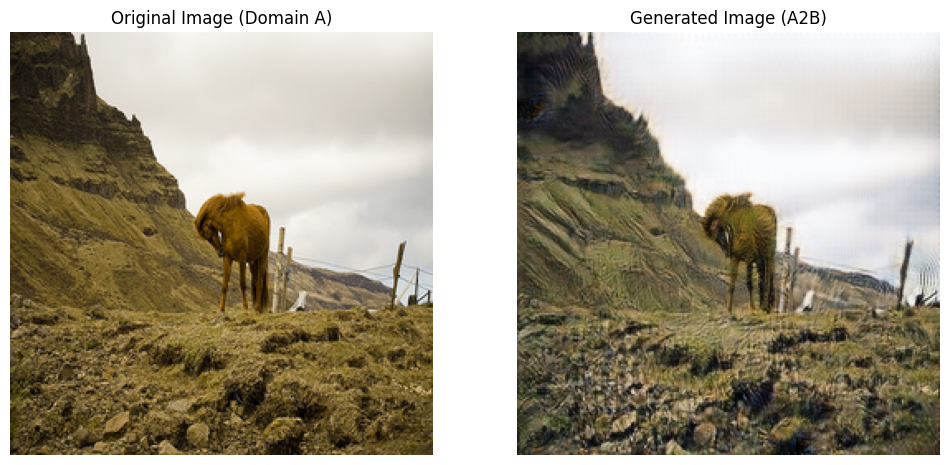

Epoch [45/50] Batch [0/1334] Loss_G: 4.4564 Loss_D_A: 0.0688 Loss_D_B: 0.2268
Epoch [45/50] Batch [100/1334] Loss_G: 3.8822 Loss_D_A: 0.1621 Loss_D_B: 0.1279
Epoch [45/50] Batch [200/1334] Loss_G: 3.6368 Loss_D_A: 0.1368 Loss_D_B: 0.0500
Epoch [45/50] Batch [300/1334] Loss_G: 4.4590 Loss_D_A: 0.1014 Loss_D_B: 0.1410
Epoch [45/50] Batch [400/1334] Loss_G: 3.4383 Loss_D_A: 0.4516 Loss_D_B: 0.0646
Epoch [45/50] Batch [500/1334] Loss_G: 3.2748 Loss_D_A: 0.1690 Loss_D_B: 0.1468
Epoch [45/50] Batch [600/1334] Loss_G: 5.0852 Loss_D_A: 0.1445 Loss_D_B: 0.0938
Epoch [45/50] Batch [700/1334] Loss_G: 3.6838 Loss_D_A: 0.1702 Loss_D_B: 0.2047
Epoch [45/50] Batch [800/1334] Loss_G: 3.2892 Loss_D_A: 0.0829 Loss_D_B: 0.0609
Epoch [45/50] Batch [900/1334] Loss_G: 4.8119 Loss_D_A: 0.1548 Loss_D_B: 0.0510
Epoch [45/50] Batch [1000/1334] Loss_G: 4.0022 Loss_D_A: 0.1137 Loss_D_B: 0.1587
Epoch [45/50] Batch [1100/1334] Loss_G: 2.9728 Loss_D_A: 0.2670 Loss_D_B: 0.1511
Epoch [45/50] Batch [1200/1334] Loss_G: 

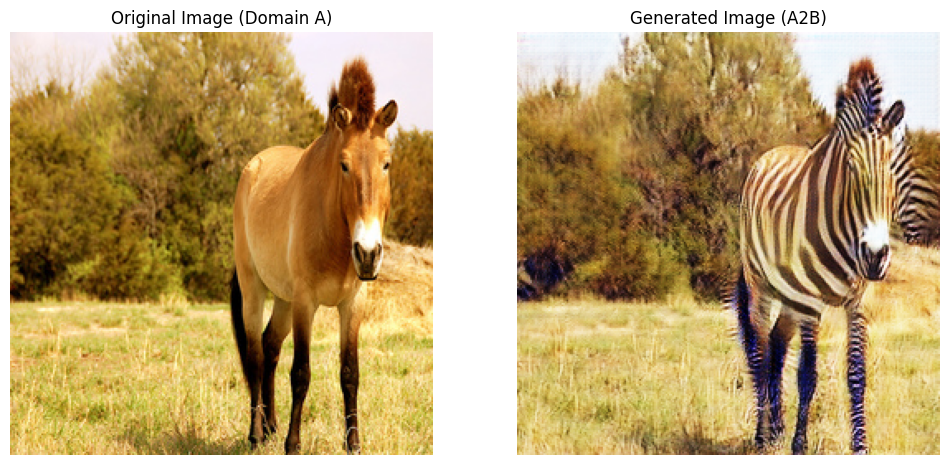

Epoch [46/50] Batch [0/1334] Loss_G: 3.8166 Loss_D_A: 0.1302 Loss_D_B: 0.0480
Epoch [46/50] Batch [100/1334] Loss_G: 3.5946 Loss_D_A: 0.0806 Loss_D_B: 0.1253
Epoch [46/50] Batch [200/1334] Loss_G: 4.5281 Loss_D_A: 0.1623 Loss_D_B: 0.1125
Epoch [46/50] Batch [300/1334] Loss_G: 3.6758 Loss_D_A: 0.1001 Loss_D_B: 0.0515
Epoch [46/50] Batch [400/1334] Loss_G: 3.3586 Loss_D_A: 0.1420 Loss_D_B: 0.1582
Epoch [46/50] Batch [500/1334] Loss_G: 4.5891 Loss_D_A: 0.1165 Loss_D_B: 0.0418
Epoch [46/50] Batch [600/1334] Loss_G: 3.9827 Loss_D_A: 0.1847 Loss_D_B: 0.2628
Epoch [46/50] Batch [700/1334] Loss_G: 3.7252 Loss_D_A: 0.2093 Loss_D_B: 0.1033
Epoch [46/50] Batch [800/1334] Loss_G: 3.5215 Loss_D_A: 0.1187 Loss_D_B: 0.0937
Epoch [46/50] Batch [900/1334] Loss_G: 4.3703 Loss_D_A: 0.1427 Loss_D_B: 0.1038
Epoch [46/50] Batch [1000/1334] Loss_G: 3.6670 Loss_D_A: 0.1160 Loss_D_B: 0.0751
Epoch [46/50] Batch [1100/1334] Loss_G: 4.8463 Loss_D_A: 0.3418 Loss_D_B: 0.0919
Epoch [46/50] Batch [1200/1334] Loss_G: 

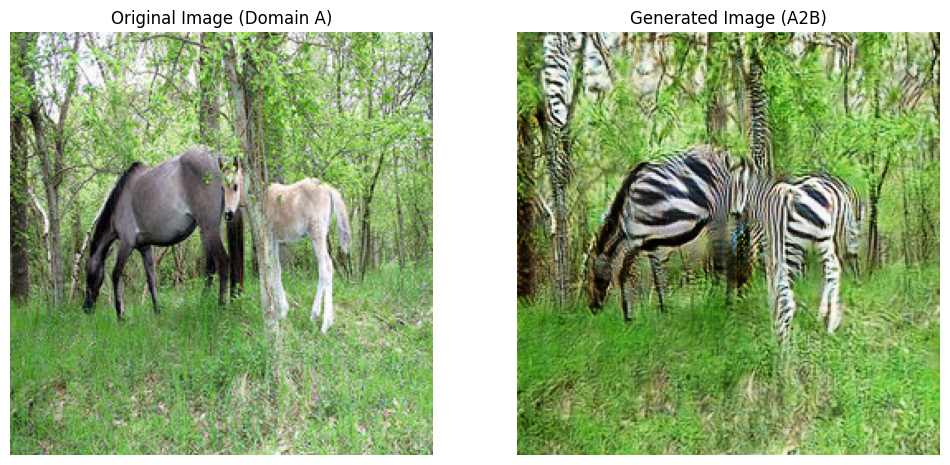

Epoch [47/50] Batch [0/1334] Loss_G: 4.4492 Loss_D_A: 0.1320 Loss_D_B: 0.0616
Epoch [47/50] Batch [100/1334] Loss_G: 3.8500 Loss_D_A: 0.1240 Loss_D_B: 0.1199
Epoch [47/50] Batch [200/1334] Loss_G: 3.6414 Loss_D_A: 0.3792 Loss_D_B: 0.2250
Epoch [47/50] Batch [300/1334] Loss_G: 5.9973 Loss_D_A: 0.2549 Loss_D_B: 0.0771
Epoch [47/50] Batch [400/1334] Loss_G: 4.6279 Loss_D_A: 0.1906 Loss_D_B: 0.1928
Epoch [47/50] Batch [500/1334] Loss_G: 3.6520 Loss_D_A: 0.2662 Loss_D_B: 0.1091
Epoch [47/50] Batch [600/1334] Loss_G: 3.6691 Loss_D_A: 0.1711 Loss_D_B: 0.2805
Epoch [47/50] Batch [700/1334] Loss_G: 3.9228 Loss_D_A: 0.1695 Loss_D_B: 0.2527
Epoch [47/50] Batch [800/1334] Loss_G: 4.0152 Loss_D_A: 0.1762 Loss_D_B: 0.1391
Epoch [47/50] Batch [900/1334] Loss_G: 4.1450 Loss_D_A: 0.0712 Loss_D_B: 0.0956
Epoch [47/50] Batch [1000/1334] Loss_G: 4.0652 Loss_D_A: 0.0938 Loss_D_B: 0.0732
Epoch [47/50] Batch [1100/1334] Loss_G: 4.1980 Loss_D_A: 0.0831 Loss_D_B: 0.0411
Epoch [47/50] Batch [1200/1334] Loss_G: 

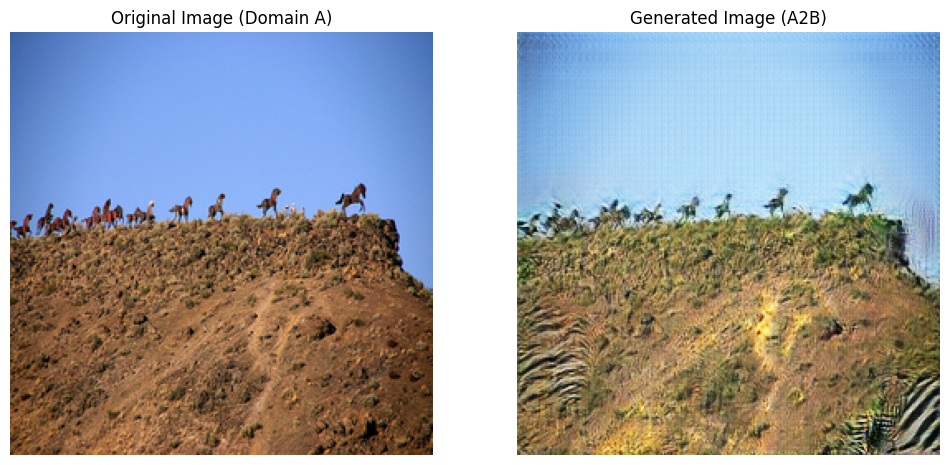

Epoch [48/50] Batch [0/1334] Loss_G: 3.5976 Loss_D_A: 0.1330 Loss_D_B: 0.1863
Epoch [48/50] Batch [100/1334] Loss_G: 3.6963 Loss_D_A: 0.0515 Loss_D_B: 0.2298
Epoch [48/50] Batch [200/1334] Loss_G: 4.7984 Loss_D_A: 0.0902 Loss_D_B: 0.0459
Epoch [48/50] Batch [300/1334] Loss_G: 4.1171 Loss_D_A: 0.2937 Loss_D_B: 0.0687
Epoch [48/50] Batch [400/1334] Loss_G: 4.0455 Loss_D_A: 0.1053 Loss_D_B: 0.0618
Epoch [48/50] Batch [500/1334] Loss_G: 3.8749 Loss_D_A: 0.5468 Loss_D_B: 0.1467
Epoch [48/50] Batch [600/1334] Loss_G: 4.6096 Loss_D_A: 0.2178 Loss_D_B: 0.1574
Epoch [48/50] Batch [700/1334] Loss_G: 5.3092 Loss_D_A: 0.0822 Loss_D_B: 0.0441
Epoch [48/50] Batch [800/1334] Loss_G: 3.8730 Loss_D_A: 0.1631 Loss_D_B: 0.1203
Epoch [48/50] Batch [900/1334] Loss_G: 4.4939 Loss_D_A: 0.1045 Loss_D_B: 0.0988
Epoch [48/50] Batch [1000/1334] Loss_G: 3.9519 Loss_D_A: 0.1287 Loss_D_B: 0.1485
Epoch [48/50] Batch [1100/1334] Loss_G: 5.2175 Loss_D_A: 0.1454 Loss_D_B: 0.0778
Epoch [48/50] Batch [1200/1334] Loss_G: 

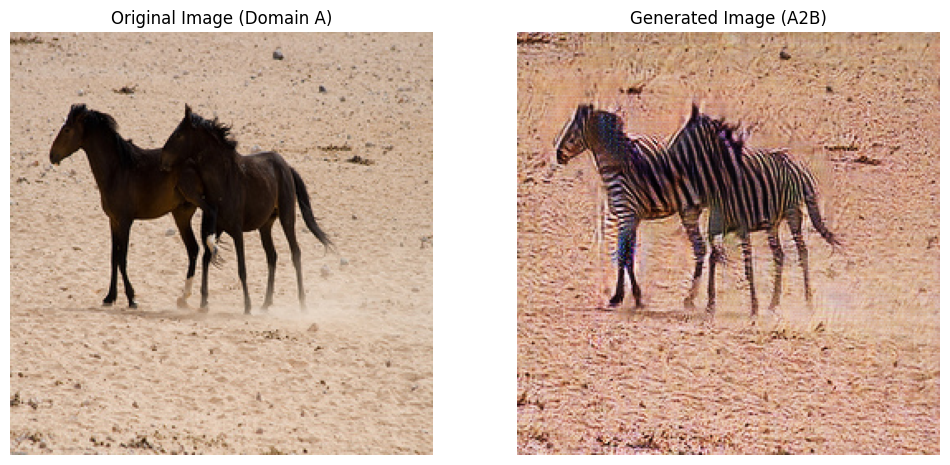

Epoch [49/50] Batch [0/1334] Loss_G: 3.5783 Loss_D_A: 0.1627 Loss_D_B: 0.2381
Epoch [49/50] Batch [100/1334] Loss_G: 4.5534 Loss_D_A: 0.1387 Loss_D_B: 0.0881
Epoch [49/50] Batch [200/1334] Loss_G: 3.3458 Loss_D_A: 0.0988 Loss_D_B: 0.0794
Epoch [49/50] Batch [300/1334] Loss_G: 4.4491 Loss_D_A: 0.3014 Loss_D_B: 0.2210
Epoch [49/50] Batch [400/1334] Loss_G: 4.4593 Loss_D_A: 0.0593 Loss_D_B: 0.0845
Epoch [49/50] Batch [500/1334] Loss_G: 3.8368 Loss_D_A: 0.1314 Loss_D_B: 0.1130
Epoch [49/50] Batch [600/1334] Loss_G: 3.5145 Loss_D_A: 0.1533 Loss_D_B: 0.2796
Epoch [49/50] Batch [700/1334] Loss_G: 5.3087 Loss_D_A: 0.1446 Loss_D_B: 0.1592
Epoch [49/50] Batch [800/1334] Loss_G: 4.6034 Loss_D_A: 0.1111 Loss_D_B: 0.0487
Epoch [49/50] Batch [900/1334] Loss_G: 3.5195 Loss_D_A: 0.1575 Loss_D_B: 0.1603
Epoch [49/50] Batch [1000/1334] Loss_G: 4.3060 Loss_D_A: 0.1199 Loss_D_B: 0.0684
Epoch [49/50] Batch [1100/1334] Loss_G: 4.1520 Loss_D_A: 0.2358 Loss_D_B: 0.1393
Epoch [49/50] Batch [1200/1334] Loss_G: 

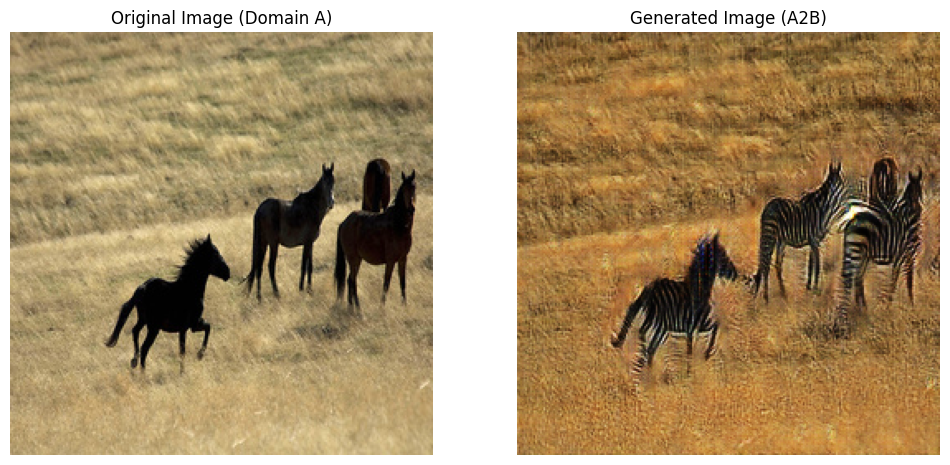

Epoch [50/50] Batch [0/1334] Loss_G: 3.8940 Loss_D_A: 0.1248 Loss_D_B: 0.0918
Epoch [50/50] Batch [100/1334] Loss_G: 4.5472 Loss_D_A: 0.0861 Loss_D_B: 0.1908
Epoch [50/50] Batch [200/1334] Loss_G: 4.3509 Loss_D_A: 0.1259 Loss_D_B: 0.0549
Epoch [50/50] Batch [300/1334] Loss_G: 4.5616 Loss_D_A: 0.1144 Loss_D_B: 0.0936
Epoch [50/50] Batch [400/1334] Loss_G: 3.8567 Loss_D_A: 0.0410 Loss_D_B: 0.0963
Epoch [50/50] Batch [500/1334] Loss_G: 4.4466 Loss_D_A: 0.0816 Loss_D_B: 0.0441
Epoch [50/50] Batch [600/1334] Loss_G: 4.9728 Loss_D_A: 0.1751 Loss_D_B: 0.0966
Epoch [50/50] Batch [700/1334] Loss_G: 6.5220 Loss_D_A: 0.0376 Loss_D_B: 0.1822
Epoch [50/50] Batch [800/1334] Loss_G: 4.2408 Loss_D_A: 0.2175 Loss_D_B: 0.1411
Epoch [50/50] Batch [900/1334] Loss_G: 3.7545 Loss_D_A: 0.2869 Loss_D_B: 0.3077
Epoch [50/50] Batch [1000/1334] Loss_G: 4.2758 Loss_D_A: 0.1146 Loss_D_B: 0.0425
Epoch [50/50] Batch [1100/1334] Loss_G: 5.2298 Loss_D_A: 0.0737 Loss_D_B: 0.0963
Epoch [50/50] Batch [1200/1334] Loss_G: 

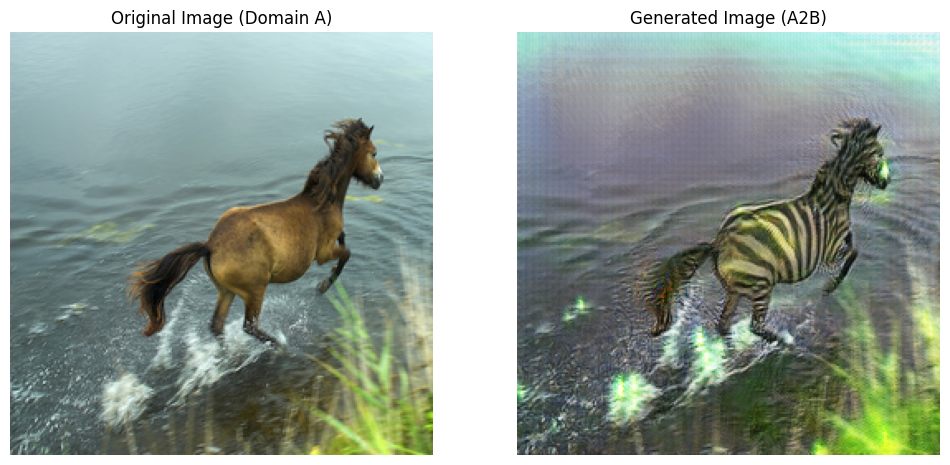

Training finished.


In [ ]:
# 1. Defining the Dataset

class ImageDataset(Dataset):
    """
    Custom dataset for CycleGAN.
    Assumes the following folder structure in /content/dataset:
        trainA/   <-- images from domain A
        trainB/   <-- images from domain B
    """
    def __init__(self, root, transforms_=None, mode='train'):
        self.transform = transforms_
        self.files_A = sorted(glob.glob(os.path.join(root, f'{mode}A') + '/*.*'))
        self.files_B = sorted(glob.glob(os.path.join(root, f'{mode}B') + '/*.*'))

    def __getitem__(self, index):
        image_A = Image.open(self.files_A[index % len(self.files_A)]).convert('RGB')
        image_B = Image.open(self.files_B[index % len(self.files_B)]).convert('RGB')

        if self.transform:
            image_A = self.transform(image_A)
            image_B = self.transform(image_B)
        return {'A': image_A, 'B': image_B}

    def __len__(self):
        return max(len(self.files_A), len(self.files_B))

# Define image transformations: resize, convert to tensor, and normalize to [-1,1]
transform = transforms.Compose([
    transforms.Resize((256, 256), Image.BICUBIC),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

# Set dataset directory
dataset_root = '/content/dataset'
train_dataset = ImageDataset(root=dataset_root, transforms_=transform, mode='train')
dataloader = DataLoader(train_dataset, batch_size=1, shuffle=True, num_workers=4)

# 2. Model Architecture

# Residual Block for Generator
class ResidualBlock(nn.Module):
    def __init__(self, channels):
        super(ResidualBlock, self).__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(channels, channels, kernel_size=3, stride=1, padding=0),
            nn.InstanceNorm2d(channels),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(channels, channels, kernel_size=3, stride=1, padding=0),
            nn.InstanceNorm2d(channels)
        )
    def forward(self, x):
        return x + self.block(x)

# Generator: ResNet-based architecture
class ResnetGenerator(nn.Module):
    def __init__(self, input_nc, output_nc, ngf=64, n_blocks=9):
        super(ResnetGenerator, self).__init__()
        assert(n_blocks >= 0)
        model = [nn.ReflectionPad2d(3),
                 nn.Conv2d(input_nc, ngf, kernel_size=7, padding=0),
                 nn.InstanceNorm2d(ngf),
                 nn.ReLU(True)]

        # Downsampling layers
        n_downsampling = 2
        for i in range(n_downsampling):
            mult = 2 ** i
            model += [nn.Conv2d(ngf * mult, ngf * mult * 2, kernel_size=3, stride=2, padding=1),
                      nn.InstanceNorm2d(ngf * mult * 2),
                      nn.ReLU(True)]

        # Residual blocks
        mult = 2 ** n_downsampling
        for i in range(n_blocks):
            model += [ResidualBlock(ngf * mult)]

        # Upsampling layers
        for i in range(n_downsampling):
            mult = 2 ** (n_downsampling - i)
            model += [nn.ConvTranspose2d(ngf * mult, int(ngf * mult / 2),
                                         kernel_size=3, stride=2,
                                         padding=1, output_padding=1),
                      nn.InstanceNorm2d(int(ngf * mult / 2)),
                      nn.ReLU(True)]

        model += [nn.ReflectionPad2d(3),
                  nn.Conv2d(ngf, output_nc, kernel_size=7, padding=0),
                  nn.Tanh()]

        self.model = nn.Sequential(*model)

    def forward(self, x):
        return self.model(x)

# Discriminator: 70x70 PatchGAN
class NLayerDiscriminator(nn.Module):
    def __init__(self, input_nc, ndf=64, n_layers=3):
        super(NLayerDiscriminator, self).__init__()
        sequence = [nn.Conv2d(input_nc, ndf, kernel_size=4, stride=2, padding=1),
                    nn.LeakyReLU(0.2, True)]
        nf_mult = 1
        for n in range(1, n_layers):
            nf_mult_prev = nf_mult
            nf_mult = min(2**n, 8)
            sequence += [
                nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=4, stride=2, padding=1),
                nn.InstanceNorm2d(ndf * nf_mult),
                nn.LeakyReLU(0.2, True)
            ]
        nf_mult_prev = nf_mult
        nf_mult = min(2**n_layers, 8)
        sequence += [
            nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=4, stride=1, padding=1),
            nn.InstanceNorm2d(ndf * nf_mult),
            nn.LeakyReLU(0.2, True)
        ]
        sequence += [nn.Conv2d(ndf * nf_mult, 1, kernel_size=4, stride=1, padding=1)]
        self.model = nn.Sequential(*sequence)

    def forward(self, x):
        return self.model(x)

# 3. Weight Initialization

def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        if hasattr(m, 'weight') and m.weight is not None:
            nn.init.normal_(m.weight, 0.0, 0.02)
    elif classname.find('InstanceNorm2d') != -1:
        if hasattr(m, 'weight') and m.weight is not None:
            nn.init.normal_(m.weight, 1.0, 0.02)
        if hasattr(m, 'bias') and m.bias is not None:
            nn.init.constant_(m.bias, 0.0)

# 4. Training Setup

# Hyperparameters
epochs = 50
batch_size = 1
lr = 0.0002
lambda_cycle = 10.0

# Device configuration: use GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Instantiate models
netG_A2B = ResnetGenerator(input_nc=3, output_nc=3, n_blocks=9).to(device)
netG_B2A = ResnetGenerator(input_nc=3, output_nc=3, n_blocks=9).to(device)
netD_A = NLayerDiscriminator(input_nc=3).to(device)
netD_B = NLayerDiscriminator(input_nc=3).to(device)

# Initialize weights
netG_A2B.apply(weights_init_normal)
netG_B2A.apply(weights_init_normal)
netD_A.apply(weights_init_normal)
netD_B.apply(weights_init_normal)

# Loss functions: Least Squares GAN loss and Cycle consistency loss (L1)
criterion_GAN = nn.MSELoss().to(device)
criterion_cycle = nn.L1Loss().to(device)

# Optimizers for generators and discriminators
optimizer_G = optim.Adam(itertools.chain(netG_A2B.parameters(), netG_B2A.parameters()),
                         lr=lr, betas=(0.5, 0.999))
optimizer_D_A = optim.Adam(netD_A.parameters(), lr=lr, betas=(0.5, 0.999))
optimizer_D_B = optim.Adam(netD_B.parameters(), lr=lr, betas=(0.5, 0.999))

# Learning rate schedulers (linear decay after 50 epochs)
lr_lambda = lambda epoch: 1.0 - max(0, epoch - 50) / 100.0
scheduler_G = optim.lr_scheduler.LambdaLR(optimizer_G, lr_lambda=lr_lambda)
scheduler_D_A = optim.lr_scheduler.LambdaLR(optimizer_D_A, lr_lambda=lr_lambda)
scheduler_D_B = optim.lr_scheduler.LambdaLR(optimizer_D_B, lr_lambda=lr_lambda)

# Function to denormalize images from [-1,1] to [0,1]
def denormalize(tensor):
    return (tensor + 1) / 2

# 5. Training Loop

for epoch in range(epochs):
    for i, batch in enumerate(dataloader):
        # Retrieve real images from both domains
        real_A = batch['A'].to(device)
        real_B = batch['B'].to(device)

        #  Train Generators
        optimizer_G.zero_grad()

        # Optional Identity Loss: encourage generators to preserve color when input is already in target domain.
        loss_id_A = criterion_cycle(netG_B2A(real_A), real_A)
        loss_id_B = criterion_cycle(netG_A2B(real_B), real_B)
        loss_identity = (loss_id_A + loss_id_B) * 0.5 * lambda_cycle

        # GAN Loss for generator A2B: fool discriminator B
        fake_B = netG_A2B(real_A)
        pred_fake_B = netD_B(fake_B)
        loss_GAN_A2B = criterion_GAN(pred_fake_B, torch.ones_like(pred_fake_B, device=device))

        # GAN Loss for generator B2A: fool discriminator A
        fake_A = netG_B2A(real_B)
        pred_fake_A = netD_A(fake_A)
        loss_GAN_B2A = criterion_GAN(pred_fake_A, torch.ones_like(pred_fake_A, device=device))

        loss_GAN = loss_GAN_A2B + loss_GAN_B2A

        # Cycle Consistency Loss: A -> B -> A and B -> A -> B should reconstruct the original images
        rec_A = netG_B2A(fake_B)
        loss_cycle_A = criterion_cycle(rec_A, real_A)

        rec_B = netG_A2B(fake_A)
        loss_cycle_B = criterion_cycle(rec_B, real_B)
        loss_cycle = (loss_cycle_A + loss_cycle_B) * lambda_cycle

        # Total Generator Loss
        loss_G = loss_GAN + loss_cycle + loss_identity
        loss_G.backward()
        optimizer_G.step()

        #  Train Discriminator A
        optimizer_D_A.zero_grad()
        # Real loss for discriminator A
        pred_real_A = netD_A(real_A)
        loss_D_A_real = criterion_GAN(pred_real_A, torch.ones_like(pred_real_A, device=device))
        # Fake loss for discriminator A
        pred_fake_A = netD_A(fake_A.detach())
        loss_D_A_fake = criterion_GAN(pred_fake_A, torch.zeros_like(pred_fake_A, device=device))
        loss_D_A_total = (loss_D_A_real + loss_D_A_fake) * 0.5
        loss_D_A_total.backward()
        optimizer_D_A.step()

        #  Train Discriminator B
        optimizer_D_B.zero_grad()
        # Real loss for discriminator B
        pred_real_B = netD_B(real_B)
        loss_D_B_real = criterion_GAN(pred_real_B, torch.ones_like(pred_real_B, device=device))
        # Fake loss for discriminator B
        pred_fake_B = netD_B(fake_B.detach())
        loss_D_B_fake = criterion_GAN(pred_fake_B, torch.zeros_like(pred_fake_B, device=device))
        loss_D_B_total = (loss_D_B_real + loss_D_B_fake) * 0.5
        loss_D_B_total.backward()
        optimizer_D_B.step()

        #  Logging
        if i % 100 == 0:
            print(f"Epoch [{epoch+1}/{epochs}] Batch [{i}/{len(dataloader)}] "
                  f"Loss_G: {loss_G.item():.4f} "
                  f"Loss_D_A: {loss_D_A_total.item():.4f} "
                  f"Loss_D_B: {loss_D_B_total.item():.4f}")

    # Update learning rate schedulers after each epoch
    scheduler_G.step()
    scheduler_D_A.step()
    scheduler_D_B.step()

    # Save model checkpoints every 10 epochs
    if (epoch + 1) % 10 == 0:
        torch.save(netG_A2B.state_dict(), f'/content/netG_A2B_epoch_{epoch+1}.pth')
        torch.save(netG_B2A.state_dict(), f'/content/netG_B2A_epoch_{epoch+1}.pth')
        print(f"Saved checkpoints at epoch {epoch+1}")

    #  Display Original and Generated Images

    # Using the last batch's real_A as input.
    with torch.no_grad():
        # Use a sample from domain A and generate its translation
        sample_real_A = real_A 
        sample_fake_B = netG_A2B(sample_real_A)

        # Denormalize for visualization
        sample_real_A = denormalize(sample_real_A).cpu()
        sample_fake_B = denormalize(sample_fake_B).cpu()

        # Create grids 
        grid_real = vutils.make_grid(sample_real_A, padding=2, normalize=True)
        grid_fake = vutils.make_grid(sample_fake_B, padding=2, normalize=True)

        # Display side-by-side
        fig, ax = plt.subplots(1, 2, figsize=(12, 6))
        ax[0].imshow(grid_real.permute(1, 2, 0))
        ax[0].set_title('Original Image (Domain A)')
        ax[0].axis('off')
        ax[1].imshow(grid_fake.permute(1, 2, 0))
        ax[1].set_title('Generated Image (A2B)')
        ax[1].axis('off')
        plt.show()

print("Training finished.")

### 5. Conclusion
This project demonstrates the implementation and training of a CycleGAN for unpaired image-to-image translation. Using an unpaired dataset, the model learned to translate images from Domain A to Domain B while preserving the key content via the cycle-consistency constraint. The experimental results show that after multiple epochs, the generated images closely resemble the target domain, affirming the effectiveness of CycleGAN in scenarios where paired data is unavailable.

Overall, the project successfully reproduces the core ideas from the original research paper and highlights the potential of unpaired translation methodologies in various image transformation tasks but there is still room for further tuning the model, experimenting with different architectures or loss functions, and evaluating the results more quantitatively using other metrics.